In [1]:
###### This script is to make the panels for Figure 4 and the related supp. figures

##### 


In [3]:
import os, sys
import warnings
warnings.filterwarnings('ignore')
import numpy as np 
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

import pickle

import pandas as pd
from random import sample
from scipy.stats import zscore
from operator import itemgetter
from scipy.signal import find_peaks
from scipy import stats
from matplotlib import cm

In [4]:
# import distinctipy
# from distinctipy import colorblind
# from distinctipy import examples
# from matplotlib.colors import ListedColormap

In [5]:
#### function to order matrices based on correlation
#### based on https://wil.yegelwel.com/cluster-correlation-matrix/
import scipy
import scipy.cluster.hierarchy as sch
import seaborn as sns

def cluster_corr(corr_array, inplace=False):
    """
    Rearranges the correlation matrix, corr_array, so that groups of highly 
    correlated variables are next to eachother 
    
    Parameters
    ----------
    corr_array : pandas.DataFrame or numpy.ndarray
        a NxN correlation matrix 
        
    Returns
    -------
    pandas.DataFrame or numpy.ndarray
        a NxN correlation matrix with the columns and rows rearranged
    """
    pairwise_distances = sch.distance.pdist(corr_array)
    linkage = sch.linkage(pairwise_distances, method='complete')
    cluster_distance_threshold = pairwise_distances.max()/2
    idx_to_cluster_array = sch.fcluster(linkage, cluster_distance_threshold, 
                                        criterion='distance')
    idx = np.argsort(idx_to_cluster_array)
    
    if not inplace:
        corr_array = corr_array.copy()
    
    if isinstance(corr_array, pd.DataFrame):
        return corr_array.iloc[idx, :].T.iloc[idx, :]
    return corr_array[idx, :][:, idx], idx

In [6]:
#### path to data
p = '/nrs/ahrens/Emmanuel/multFISH/DataForFigshare'

In [7]:
p

'/nrs/ahrens/Emmanuel/multFISH/DataForFigshare'

In [8]:
##### loading matrices and variables

##### (cells x timeseries) calcium signal of cells positive for at least one gene. Cells of the 3 fish 
##### Note: it has 120 timepoints less due to NMF calculation.
dff_traceAll = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/dff_traceAll.npy')

##### (cells x genes) spot count of genes for cells positive for at least one gene. Cells of the 3 fish.
genes_df_All = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/genes_df_All.npy')

### Gene matrix with nans instead of 0s 
genes_df_All_nans = np.empty((genes_df_All.shape))
genes_df_All_nans[:] = np.nan
genes_df_All_nans[np.where(genes_df_All)] = genes_df_All[np.where(genes_df_All)]

#### to replicate the order we originally got
gene_names = ['cart2','glyt2','tac1','pvalb7','npb','grm1b','irx1b','dat','net','calb1',
              'penka','penkb','eomesa','emx3','cfos','gad1b','cx43','vglut2a','sst','uts1',
              'pou4f2','cort','nr4a2a','cckb','tph2','chata','calb2a','npy','gfra1a','dmbx1a',
              'gbx2','crhb','nefma','chodl','pyya','zic2a','th','pdyn','tbr1b','otpa','esrrb']


#### list of genes without cfos
gene_names_NoCfos = gene_names.copy()
gene_names_NoCfos.pop(gene_names.index('cfos'))

##### (cells x genes) binary classification of gene expression of cells positive for at least one gene. Cells of the 3 fish.
BinaryGenes_All = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/BinaryGenes_All.npy')

#### (genes) indexes of the 41 genes to sort them by number of positive cells.
genes_sorted = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/genes_sorted.npy') ###

### not using cfos for subtypes
BinaryGenes_All_NoCfos = np.copy(BinaryGenes_All)
BinaryGenes_All_NoCfos = np.delete(BinaryGenes_All_NoCfos, gene_names.index('cfos'), axis=1)
BinaryGenes_All_NoCfos.shape

##### 3D (z, x, y) coordinates in atlas space of cells positive for at least one gene. Cells of the 3 fish.
Coords_All = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/Coords_All.npy')

##### (cells x brain regions) binary classification of presence in one of the 112 brain regions of cells positive for at least one gene. Cells of the 3 fish.
BrainRegions_All = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/BrainRegions_All.npy')

##### (cells) Fish ID of cells positive for at least one gene. Cells of the 3 fish.
fish_id = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/fish_id.npy')

fish_list = list(np.unique(fish_id))

#### fish new ID
fish_id2 = fish_id.copy()
fish_id2[np.where(fish_id==59)] = 1
fish_id2[np.where(fish_id==63)] = 2
fish_id2[np.where(fish_id==71)] = 3

##### (cells x coords) = coordinates for the results of t-SNE. For cells positive for at least one gene. Cells of the 3 fish.
tsne_results = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/tsne_results_20240527.npy')

##### list of brain region names from the atlas
BrainRegions_names = np.load(p+'/Fish1/region_names.npy')

#### ideces of brain regions of interest
GoodReg = np.stack((
np.where(BrainRegions_names=='inferior_medulla_oblongata')[0],
np.where(BrainRegions_names=='intermediate_medulla_oblongata')[0],
np.where(BrainRegions_names=='superior_medulla_oblongata')[0],
np.where(BrainRegions_names=='superior_raphe')[0],
np.where(BrainRegions_names=='cerebellum')[0],
np.where(BrainRegions_names=='tegmentum')[0],
np.where(BrainRegions_names=='nucleus_isthmi')[0],
np.where(BrainRegions_names=='periventricular_layer')[0],
np.where(BrainRegions_names=='tectal_neuropil')[0],
np.where(BrainRegions_names=='pretectum')[0],     
np.where(BrainRegions_names=='prethalamus_(ventral_thalamus)')[0],
np.where(BrainRegions_names=='dorsal_thalamus_proper')[0],
np.where(BrainRegions_names=='habenula')[0],
np.where(BrainRegions_names=='hypothalamus')[0],
np.where(BrainRegions_names=='ventral_telencephalon_(subpallium)')[0],
np.where(BrainRegions_names=='dorsal_telencephalon_(pallium)')[0],),axis=1)

GoodReg = GoodReg[0]

#### abbreviations of the selected brain regions
BrainRegions_names_short = ['InfMO', 'IntMO', 'SupMO', 'SupRaphe', 'Cb', 'Tg', 'NI', 'OTpv', 'OTnp', 'Pt', 
                            'preTh', 'Th', 'Hab', 'HypTh', 'SubP', 'Pal']

##### color labeling for brain regions
n=len(BrainRegions_names_short)
colors_Brain = plt.cm.nipy_spectral(np.linspace(0,1,n))

colors_B = plt.cm.nipy_spectral(np.linspace(0,1,len(BrainRegions_names_short)+2))
colors_B.shape

#### (cells) labes from 1-16 for the selected brain regions. For cells positive for at least one gene. Cells of the 3 fish.
Brain_reg = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/Brain_reg.npy')

#### (unique combinations x genes) = 332 unique combinations for positive gene expression based on the 40 genes (not using cfos). 
#### This was obtained with a function that also take into account a minimum number of cells and replicates across fish. 
#### get_unique_types(min_neighbor_thr = 2, count_thr = 5, dist_thr= 40). 
unique_types_full = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/unique_types_full.npy')

###### (cells) integer labeling for the cell subtypes based on the unique combinations. For cells positive for at least one gene. Cells of the 3 fish.
cluster_labelsAll2 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/cluster_labelsAll2.npy')

##### (subtypes) 332 names for the unique subtypes based on the genes they express.
good_cls_names = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/good_cls_names.npy')

##### (glia subtypes) = labels of the subtypes that were identified with cx43
glia_subs_og = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/glia_subs_og.npy')

#### (subtypes) count of genes present in each of the 332 subtypes. 
g_in_cls_og = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/g_in_cls_og.npy') ###

#### (subtypes) indexes of the 332 subtypes to sort them by number of cells.
subtyps_sorted = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/subtyps_sorted.npy') ###

###### (cells) integer labeling for the cell subtypes reassigning subtype labels based on order of more expression. For cells positive for at least one gene. Cells of the 3 fish.
cluster_labelsAll3 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/cluster_labelsAll3.npy')

##### (glia subtypes) = labels of the subtypes that were identified with cx43, after they were sorted with subtyps_sorted.
glia_subs = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/glia_subs.npy')

#### (subtypes) count of genes present in each of the 332 subtypes, after they were sorted with subtyps_sorted.
g_in_cls = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/g_in_cls.npy') ###

#### subtype names sorted
good_cls_names = list(np.array(good_cls_names)[subtyps_sorted-1]) ### indexing in names starts at 0

#### colors for subtypes
colors_All = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/colors_All.npy')
cmap_All= ListedColormap(colors_All)

##### (cells) binary classification of cells an imaged planes for cells positive for at least one gene. Cells of the 3 fish.
in_planeAll= np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/in_planeAll.npy')

###### stimuli and correlation results

#### list of stimuli
stim = ['forward', 'backward','right','left','dark-flash','bright-flash','right-loom','left-loom']

#### list of stimuli (full name) 
stim_full = ['forward visual motion',
            'backward visual motion',
            'rightward visual motion',
            'leftward visual motion',
            'Dark flash',
            'Bright flash',
            'Right loom',
            'Left loom',]

#### (stimuli x timeseries) matrix containing for each stimulus (row) the with timings of stimulus presentations and period of expected calcium responses (columns).
regressors= np.load('/nrs/ahrens/Emmanuel/multFISH/MF53_first_release/regressors_SimpleSqr.npy')

#### (cells x stimuli) Matrix with the correlation coefficient of Pearson correlations between the cells activity and the regressors_SimpleSqr (rows). This was performed for each of the 8 stimuli (columns). For cells positive for at least one gene. Cells of the 3 fish.
big_corr_regsAll = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/big_corr_regsAll.npy')

#### (stimuli x timeseries) matrix containing for each stimulus (row) the with timings of dalayed calcium responses (columns).
regressors2 = np.load('/nrs/ahrens/Emmanuel/multFISH/MF51_first_release/regressors_SimpleSqr_AllDelay.npy')

#### (cells x stimuli) Matrix with the correlation coefficient of Pearson correlations between the cells activity and the regressors_SimpleSqr_AllDelay (rows). This was performed for each of the 8 stimuli (columns). For cells positive for at least one gene. Cells of the 3 fish.
big_corr_regsAllDelay = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/big_corr_regsAllDelay.npy')

#### (cells x stimuli) = matrix combining the results of the big_corr_regsAll and the big_corr_regsAllDelay, keeping the highest of both.
big_corr_regsAllMix = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/big_corr_regsAllMix.npy') 

#### percentiles of big_corr_regsAllMix
perc5 = np.percentile(big_corr_regsAllMix[:,0],[5, 10, 25, 59, 75, 90, 95])

#### (cells, stimuli, presentation) = Matrix with the correlation coefficient of Pearson correlations between the cells activity and the regressors_SimpleSqr (1st dimension). This was performed for each of the 8 stimuli (2nd dimension) and for the 2nd to the 10th presentations (3rd dimension). For cells positive for at least one gene. Cells of the 3 fish.
corr_stimAll = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/corr_stimAll.npy') 

#### (cells, stimuli, presentation) same as above but for the delayed responses (regressors_SimpleSqr_AllDelay).
corr_stimAll2 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/corr_stimAll2.npy') ###

#### (cells x stimuli) Median of the presentation’s correlation coefficients from corr_stimAll.
high_corr_perSim = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/high_corr_perSim.npy') ###

#### (cells x stimuli) Median of the presentation’s correlation coefficients from corr_stimAll2.
high_corr_perSim2 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/high_corr_perSim2.npy') ###

#### (cells x stimuli) = matrix combining the results of the high_corr_perSim and the high_corr_perSim2, keeping the highest of both.
high_corr_perSimMix = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/high_corr_perSimMix.npy') ###

#### percentiles of high_corr_perSimMix
perc3 = np.percentile(high_corr_perSimMix[:,0],[5, 10, 25, 59, 75, 90, 95])

### finding average per stimuli
for s in range(1,8,1):
    perc3 = np.vstack((perc3, np.percentile(high_corr_perSimMix[:,s],[5, 10, 25, 59, 75, 90, 95])))
    perc5 = np.vstack((perc5, np.percentile(big_corr_regsAllMix[:,s],[5, 10, 25, 59, 75, 90, 95])))
    
perc3mean = np.mean(perc3,0)
perc5mean = np.mean(perc5,0)


#### (cells x timeseries) Average calcium activity of the 9 presentations (2nd to 10th) to have a representative trail (268 timepoints). For cells positive for at least one gene. Cells of the 3 fish.
dff_traceAllavg = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/dff_traceAllavg.npy') ###

#### (stimuli x timeseries) Average of the of the 9 presentations (2nd to 10th) of  regressors_SimpleSqr to have a representative trail (268 timepoints).
regressors_avg = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/regressors_avg.npy') ###

##### (stimuli, presentation, moment) start and end time stamps for each of the stimulus (1st dimension) and each of the 10 presentations (2nd dimension). At 6kHz.
stim_timings = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/stim_timings.npy') ###
stim_timings.shape

##### (closed-loop period, moment) start and end time stamps for each of the 80 closed-loop periods during the experiment. At 6kHz.
stim_timings2 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/stim_timings2.npy') ###
stim_timings2.shape

##### (stimuli, presentation, moment) start and end time stamps for each of the stimulus (1st dimension) and each of the 10 presentations (2nd dimension). Down sampled to match the calcium timepoints, at 2Hz.
stim_timings_ds = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/stim_timings_ds.npy') ###

##### (closed-loop period, moment) start and end time stamps for each of the 80 closed-loop periods during the experiment. Down sampled to match the calcium timepoints, at 2Hz.
stim_timings2_ds = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/stim_timings2_ds.npy') ###

#### swim trace (ephys resolution) 
swim_power_59 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_power_59.npy') ###

#### swim trace (imaging resolution) 
swim_power_good59 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_power_good59.npy') ###

#### swim trace (ephys resolution) 
swim_power_63 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_power_63.npy') ###

#### swim trace (imaging resolution) 
swim_power_good63 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_power_good63.npy') ###

#### swim trace (ephys resolution)
swim_power_71 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_power_71.npy') ###

#### swim trace (imaging resolution) 
swim_power_good71 = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_power_good71.npy') ###

##### (cells) Pearson correlation coefficient of the calcium activity and the estimated swim power. For cells positive for at least one gene. Cells of the 3 fish.
swim_corr_All = np.load('/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/postprocessed/swim_corr_All.npy')
swim_corr_All.shape

print('data loaded')

data loaded


Text(0.5, 1.0, 'colors for subtypes')

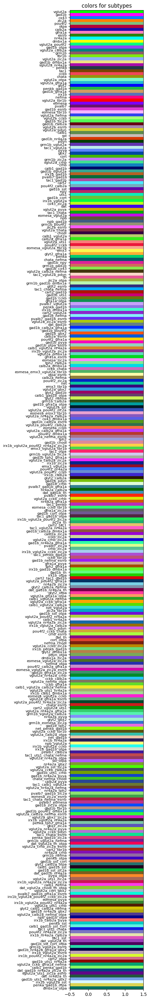

In [9]:
#### colors for subtypes
test_colors = np.zeros((len(colors_All)))
for i in range(len(colors_All)):
    test_colors[i] = i + 1

test_colors = np.vstack((test_colors,test_colors))

plt.figure(figsize = (3,40))
plt.imshow(test_colors.T, aspect='auto', cmap=cmap_All,vmin=1, vmax=332)
plt.yticks(range(len(colors_All)),np.array(good_cls_names), fontsize=8) 
plt.title('colors for subtypes')

332


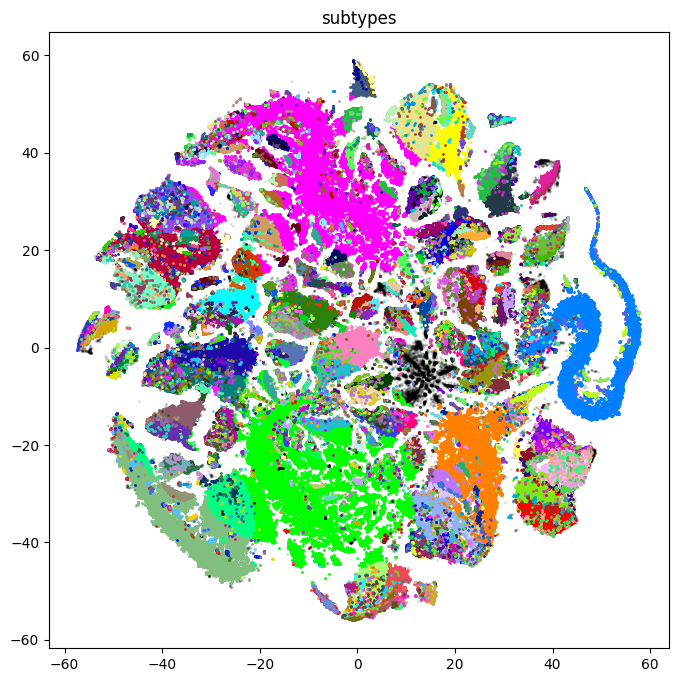

In [10]:
### plotting tsne visualization

plt.figure(figsize=(8,8))

plt.scatter(tsne_results[:,0],tsne_results[:,1], c = 'k', alpha = 0.1,s=1)

count = 0
for cl in np.unique(cluster_labelsAll3[np.where(cluster_labelsAll3>0)[0]]):
    temp = np.where(cluster_labelsAll3==cl)[0]
    if len(temp)>20:
        temp2 = fish_id[temp]
        if len(np.unique(temp2)) > 2: #### 
            if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:
                           
                plt.scatter(tsne_results[temp,0],tsne_results[temp,1], alpha = 1,s=1,c=colors_All[cl-1])
                count = count+1

plt.title('subtypes')

print(count)

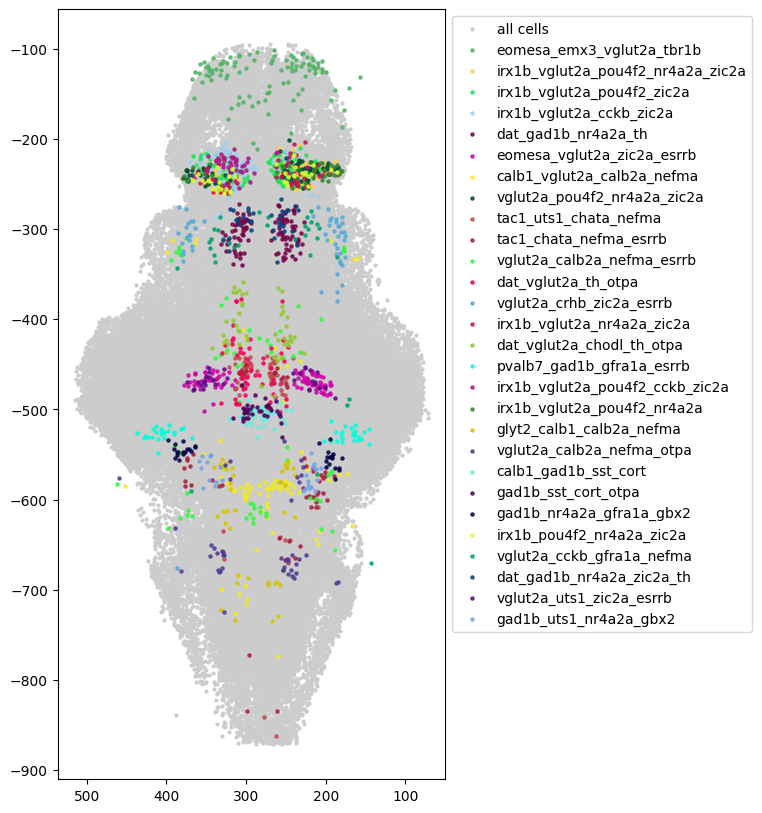

In [11]:
#### checking subtypes with 4 genes or more

minG = 4 #### minimum number of genes in a subtype

temp_f = np.where(fish_id==59)[0]

plt.figure(figsize=(5,10))
plt.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)


names = ['all cells']

for i, cl in enumerate(list(np.unique(cluster_labelsAll3)[1::][np.where(g_in_cls>=minG)[0]])):
    if cl in glia_subs:
        continue
    temp = np.where(cluster_labelsAll3==cl)[0]
    # print(cl)


    temp2 = fish_id[temp]


    if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:

        if len(np.where(temp2==59)[0])/len(temp2)>0.70 or len(np.where(temp2==63)[0])/len(temp2)>0.70 or len(np.where(temp2==71)[0])/len(temp2)>0.70:
            # print(x, good_cls_names[i], BrainRegions_names[b])
            # print(len(np.where(temp2==59)[0])/len(temp2), len(np.where(temp2==63)[0])/len(temp2), len(np.where(temp2==71)[0])/len(temp2))
            continue
    
        plt.scatter(Coords_All[temp,1],Coords_All[temp,2]*-1,s=5,alpha=0.8,c=colors_All[cl-1])
        
        names.append(good_cls_names[np.where(g_in_cls>=minG)[0][i]])
plt.gca().invert_xaxis()  # Invert the x-axis
plt.legend(names, bbox_to_anchor=(1, 1))

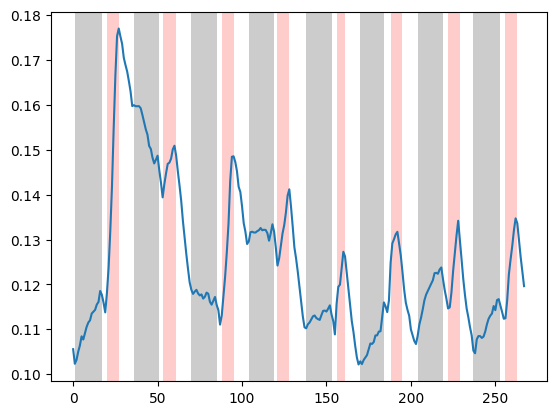

In [12]:
##### plotting mean activity for a representative trail and the stimulus presentations
##### for just stimulus presentation (at 2Hz)

plt.figure()
plt.plot(np.nanmean(dff_traceAllavg,0))

for s in range(8):
    dark = 0.2

    plt.axvspan((stim_timings_ds[s,0,0]),(stim_timings_ds[s,0,1]),alpha=dark, facecolor='r')
    plt.axvspan((stim_timings2_ds[s,0]),(stim_timings2_ds[s,1]),alpha=0.2, facecolor='k')

In [13]:
#################

In [14]:
#### getting averages per fish

avg_spots_mat59 = np.zeros((len(GoodReg),genes_df_All.shape[1]))
pos_cells_mat59 = np.zeros((len(GoodReg),genes_df_All.shape[1]))
pos_cells_ratio_mat59 = np.zeros((len(GoodReg),genes_df_All.shape[1]))
avg_spots_mat63 = np.zeros((len(GoodReg),genes_df_All.shape[1]))
pos_cells_mat63 = np.zeros((len(GoodReg),genes_df_All.shape[1]))
pos_cells_ratio_mat63 = np.zeros((len(GoodReg),genes_df_All.shape[1]))
avg_spots_mat71 = np.zeros((len(GoodReg),genes_df_All.shape[1]))
pos_cells_mat71 = np.zeros((len(GoodReg),genes_df_All.shape[1]))
pos_cells_ratio_mat71 = np.zeros((len(GoodReg),genes_df_All.shape[1]))


for b in range(len(GoodReg)):
        
    temp_means59 = np.zeros((genes_df_All.shape[1]))
    temp_cells59 = np.zeros((genes_df_All.shape[1])) 
    temp_cellsRatio59 = np.zeros((genes_df_All.shape[1]))  
    temp_means63 = np.zeros((genes_df_All.shape[1]))
    temp_cells63 = np.zeros((genes_df_All.shape[1])) 
    temp_cellsRatio63 = np.zeros((genes_df_All.shape[1])) 
    temp_means71 = np.zeros((genes_df_All.shape[1]))
    temp_cells71 = np.zeros((genes_df_All.shape[1]))
    temp_cellsRatio71 = np.zeros((genes_df_All.shape[1]))

    
    tempf = np.where(fish_id==59)[0]
    temp1 = np.where(BrainRegions_All[:,GoodReg[b]]==1)[0]
    temp1 = np.intersect1d(temp1,tempf)
   
    for i in range(genes_df_All.shape[1]): 
        temp2=np.where(BinaryGenes_All[temp1,i])[0]   
        if len(temp2)>10:

            temp_means59[i] = np.mean(genes_df_All[temp1[temp2],i])
            temp_cells59[i] = len(temp2)
            temp_cellsRatio59[i] = len(temp2)/len(temp1)

    tempf = np.where(fish_id==63)[0]
    temp1 = np.where(BrainRegions_All[:,GoodReg[b]]==1)[0]
    temp1 = np.intersect1d(temp1,tempf)

    for i in range(genes_df_All.shape[1]): 
        temp2=np.where(BinaryGenes_All[temp1,i])[0]
        if len(temp2)>10:

            temp_means63[i] = np.mean(genes_df_All[temp1[temp2],i])
            temp_cells63[i] = len(temp2)    
            temp_cellsRatio63[i] = len(temp2)/len(temp1)
                        
    tempf = np.where(fish_id==71)[0]
    temp1 = np.where(BrainRegions_All[:,GoodReg[b]]==1)[0]
    temp1 = np.intersect1d(temp1,tempf)

    for i in range(genes_df_All.shape[1]): 
        temp2=np.where(BinaryGenes_All[temp1,i])[0]
        if len(temp2)>10:

            temp_means71[i] = np.mean(genes_df_All[temp1[temp2],i])
            temp_cells71[i] = len(temp2)  
            temp_cellsRatio71[i] = len(temp2)/len(temp1)
            
   
  
    avg_spots_mat59[b,:] = temp_means59
    pos_cells_mat59[b,:] = temp_cells59
    pos_cells_ratio_mat59[b,:] = temp_cellsRatio59
    avg_spots_mat63[b,:] = temp_means63
    pos_cells_mat63[b,:] = temp_cells63
    pos_cells_ratio_mat63[b,:] = temp_cellsRatio63
    avg_spots_mat71[b,:] = temp_means71
    pos_cells_mat71[b,:] = temp_cells71
    pos_cells_ratio_mat71[b,:] = temp_cellsRatio71


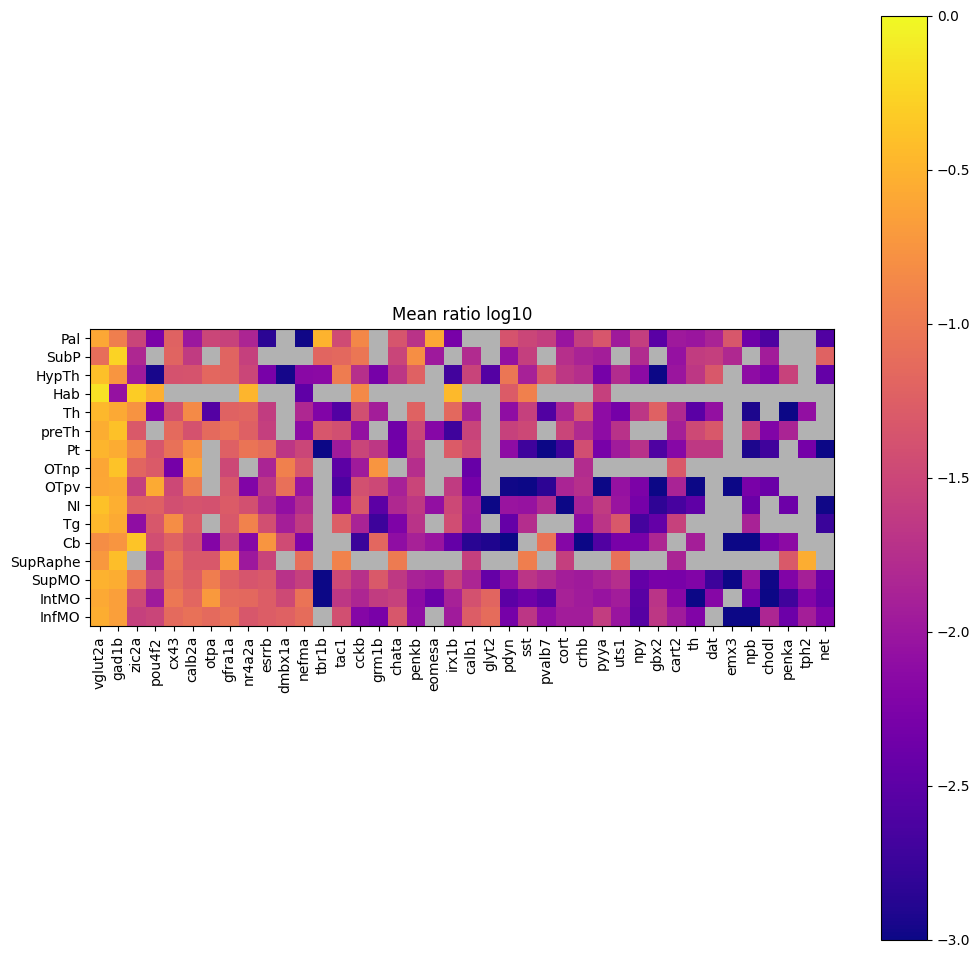

In [15]:
#### mean across fish and plot. 

plt.figure(figsize=[12,12])
cmap = plt.cm.plasma
cmap.set_bad('0.7')  # Set NaN color 
mat_avg = np.log10(np.mean(np.stack([pos_cells_ratio_mat59, pos_cells_ratio_mat63, pos_cells_ratio_mat71]),0))[::-1,genes_sorted[np.delete(np.arange(0,41),2)]]
plt.imshow(mat_avg, vmin=-3, vmax=0, cmap=cmap)
plt.colorbar()
plt.xticks(range(len(np.array(gene_names)[genes_sorted[np.delete(np.arange(0,41),2)]])),np.array(gene_names)[genes_sorted[np.delete(np.arange(0,41),2)]], rotation = 90) 
plt.yticks(range(len(GoodReg)),BrainRegions_names_short[::-1]) 
# plt.yticks(range(len(GoodReg)),BrainRegions_names[GoodReg]) 
plt.title("Mean ratio log10")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Matrix_meanratio_cells_side_colorbar.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Matrix_meanratio_cells_side_colorbar.csv", mat_avg, delimiter=",")



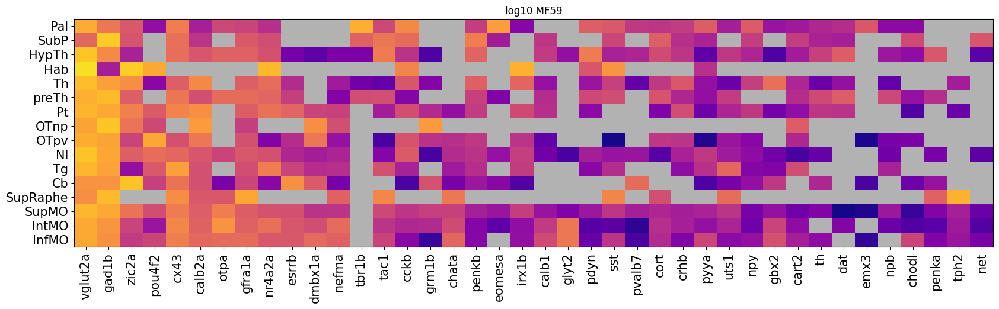

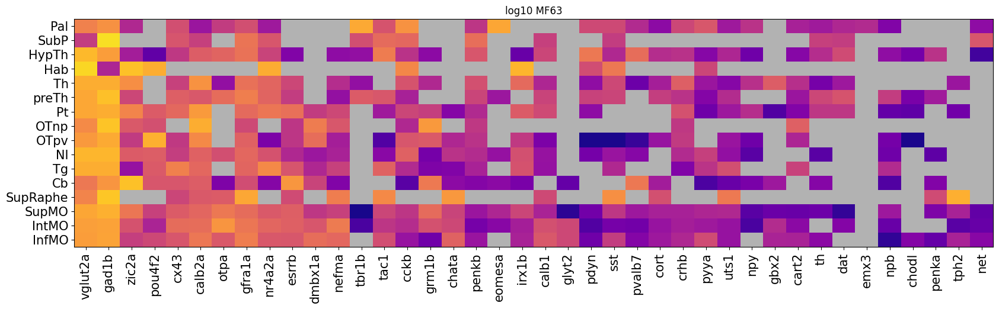

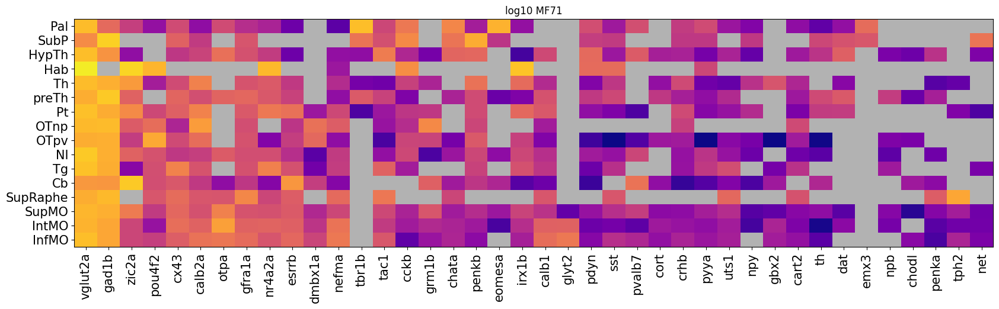

In [16]:

cmap = plt.cm.plasma
cmap.set_bad('0.7')  # Set NaN color 

plt.figure(figsize=[20,5])
plt.imshow(np.log10(pos_cells_ratio_mat59)[::-1,genes_sorted[np.delete(np.arange(0,41),2)]], vmin=-3, vmax=0, cmap=cmap,aspect='auto')
# plt.colorbar()
plt.xticks(range(len(np.array(gene_names)[genes_sorted[np.delete(np.arange(0,41),2)]])),np.array(gene_names)[genes_sorted[np.delete(np.arange(0,41),2)]], rotation = 90, fontsize=15) 
plt.yticks(range(len(GoodReg)),BrainRegions_names_short[::-1], fontsize=15) 
plt.title("log10 MF59")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Matrix_meanratio_cells_MF59.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Matrix_meanratio_cells_MF59.csv", np.log10(pos_cells_ratio_mat59)[::-1,genes_sorted[np.delete(np.arange(0,41),2)]], delimiter=",")


plt.figure(figsize=[20,5])
plt.imshow(np.log10(pos_cells_ratio_mat63)[::-1,genes_sorted[np.delete(np.arange(0,41),2)]], vmin=-3, vmax=0, cmap=cmap,aspect='auto')
# plt.colorbar()
plt.xticks(range(len(np.array(gene_names)[genes_sorted[np.delete(np.arange(0,41),2)]])),np.array(gene_names)[genes_sorted[np.delete(np.arange(0,41),2)]], rotation = 90, fontsize=15) 
plt.yticks(range(len(GoodReg)),BrainRegions_names_short[::-1], fontsize=15) 
plt.title("log10 MF63")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Matrix_meanratio_cells_MF63.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Matrix_meanratio_cells_MF63.csv", np.log10(pos_cells_ratio_mat63)[::-1,genes_sorted[np.delete(np.arange(0,41),2)]], delimiter=",")


plt.figure(figsize=[20,5])
plt.imshow(np.log10(pos_cells_ratio_mat71)[::-1,genes_sorted[np.delete(np.arange(0,41),2)]], vmin=-3, vmax=0, cmap=cmap,aspect='auto')
# plt.colorbar()
plt.xticks(range(len(np.array(gene_names)[genes_sorted[np.delete(np.arange(0,41),2)]])),np.array(gene_names)[genes_sorted[np.delete(np.arange(0,41),2)]], rotation = 90, fontsize=15) 
plt.yticks(range(len(GoodReg)),BrainRegions_names_short[::-1], fontsize=15)  
plt.title("log10 MF71")

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Matrix_meanratio_cells_MF71.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Matrix_meanratio_cells_MF71.csv", np.log10(pos_cells_ratio_mat71)[::-1,genes_sorted[np.delete(np.arange(0,41),2)]], delimiter=",")



In [17]:
###################

In [18]:
### co-expression

In [19]:
#### Proportion of a gene to be co-expressed with another gene. 

tempf = np.where(fish_id==59)[0]

co_exp59 = np.zeros((genes_df_All.shape[1],genes_df_All.shape[1]))

for i in range(genes_df_All.shape[1]):
    temp1=np.where(BinaryGenes_All[:,i])[0]
    temp1=np.intersect1d(temp1,tempf)
    for j in range(genes_df_All.shape[1]):
        temp2=np.where(BinaryGenes_All[temp1,j])[0]
        co_exp59[i,j] = len(temp2)/len(temp1)

tempf = np.where(fish_id==63)[0]

co_exp63 = np.zeros((genes_df_All.shape[1],genes_df_All.shape[1]))

for i in range(genes_df_All.shape[1]):
    temp1=np.where(BinaryGenes_All[:,i])[0]
    temp1=np.intersect1d(temp1,tempf)
    for j in range(genes_df_All.shape[1]):
        temp2=np.where(BinaryGenes_All[temp1,j])[0]
        co_exp63[i,j] = len(temp2)/len(temp1)

tempf = np.where(fish_id==71)[0]

co_exp71 = np.zeros((genes_df_All.shape[1],genes_df_All.shape[1]))

for i in range(genes_df_All.shape[1]):
    temp1=np.where(BinaryGenes_All[:,i])[0]
    temp1=np.intersect1d(temp1,tempf)
    for j in range(genes_df_All.shape[1]):
        temp2=np.where(BinaryGenes_All[temp1,j])[0]
        co_exp71[i,j] = len(temp2)/len(temp1)

(3, 41, 41)
(41, 41)


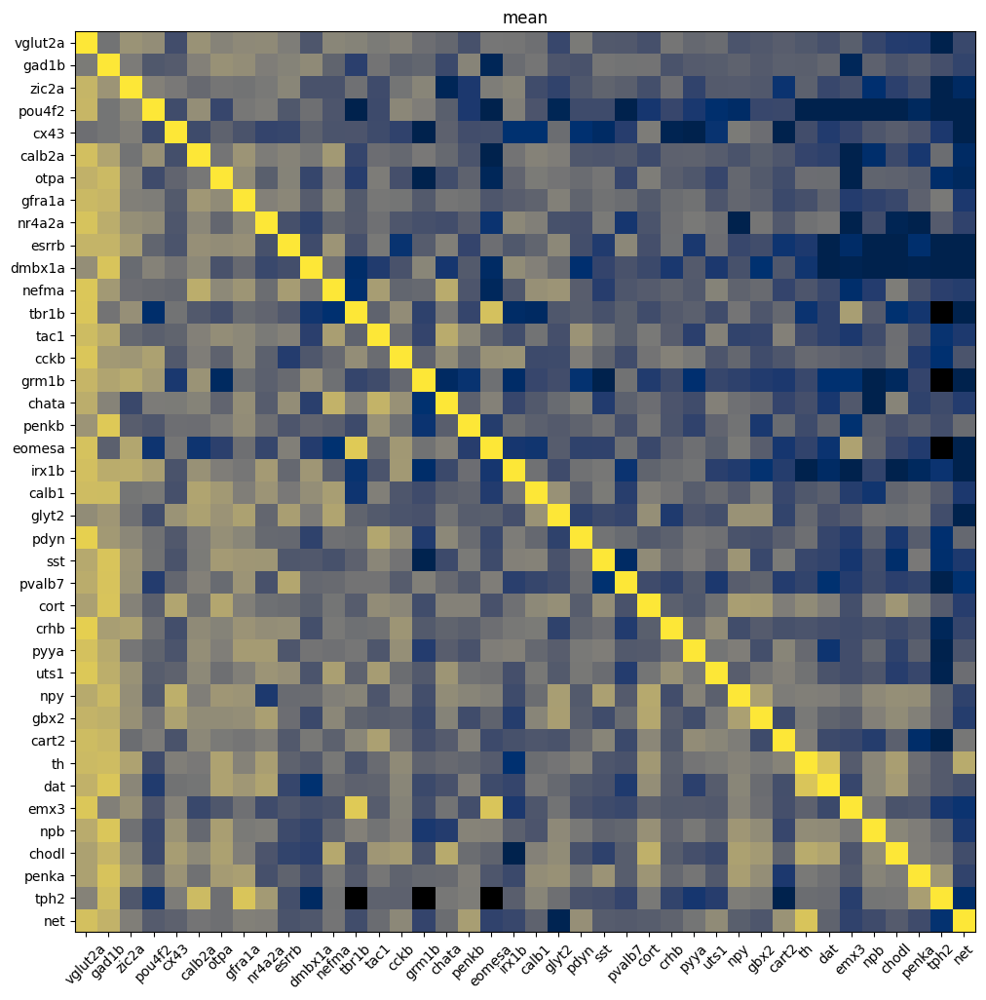

In [20]:
##### for the average

co_exp = np.stack([co_exp59,co_exp63,co_exp71])
print(co_exp.shape)
co_exp = np.mean(co_exp, 0)

co_exp_nans = np.zeros((co_exp.shape))
co_exp_nans[:]= np.nan

co_exp_nans[np.where(co_exp>0)] = co_exp[np.where(co_exp>0)]

print(co_exp.shape)
plt.figure(figsize=[12,12])
cmap = plt.cm.cividis
cmap.set_bad('0')  # Set NaN color 
plt.imshow(np.log10(co_exp_nans[:,genes_sorted[np.delete(np.arange(0,41),2)]][genes_sorted[np.delete(np.arange(0,41),2)],:]),vmin=-3,vmax=0, cmap=cmap)
# plt.colorbar()
plt.xticks(range(len(np.array(gene_names)[genes_sorted[np.delete(np.arange(0,41),2)]])),np.array(gene_names)[genes_sorted[np.delete(np.arange(0,41),2)]], rotation=45) 
plt.yticks(range(len(np.array(gene_names)[genes_sorted[np.delete(np.arange(0,41),2)]])),np.array(gene_names)[genes_sorted[np.delete(np.arange(0,41),2)]],) 
plt.title('mean')


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Matrix_coexp_mean.svg',transparent=True, dpi=300)
np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Matrix_coexp_mean.csv", np.log10(co_exp_nans[:,genes_sorted[np.delete(np.arange(0,41),2)]][genes_sorted[np.delete(np.arange(0,41),2)],:]), delimiter=",")



In [21]:
#######################

In [22]:
### tsne

In [23]:
##### tsne to visualize the genes
from sklearn.manifold import TSNE

# tsne = TSNE(n_components=2, verbose=1, perplexity=100, early_exaggeration=100, n_iter=1000)
# tsne_results = tsne.fit_transform(genes_df_All)

#### saving
# np.save('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/tsne_results_20240527.npy', tsne_results) 

tsne_results = np.load('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/tsne_results_20240527.npy')

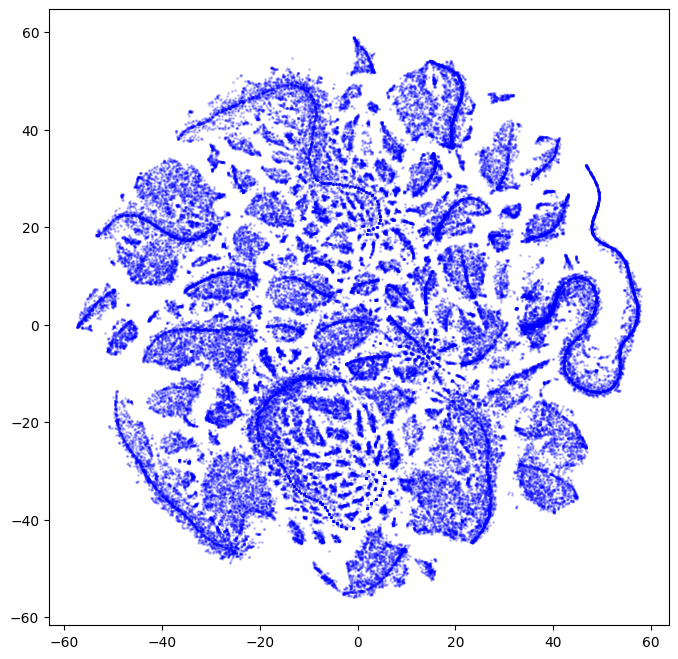

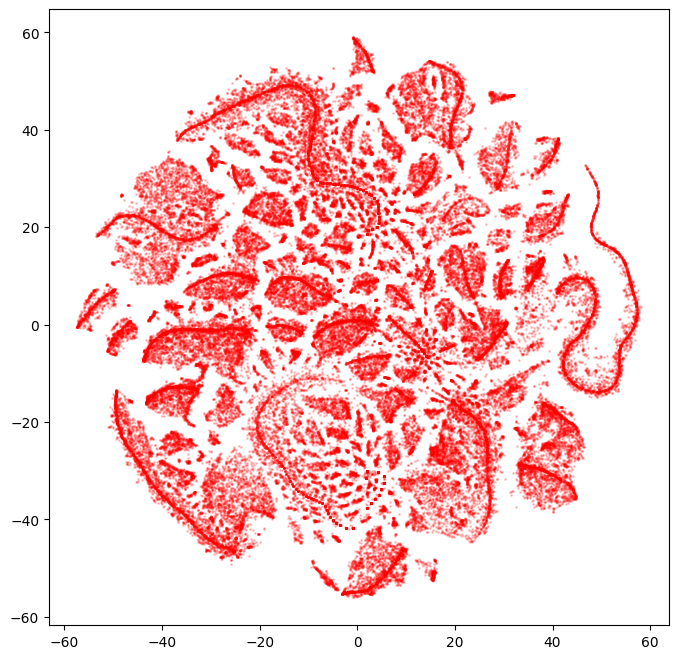

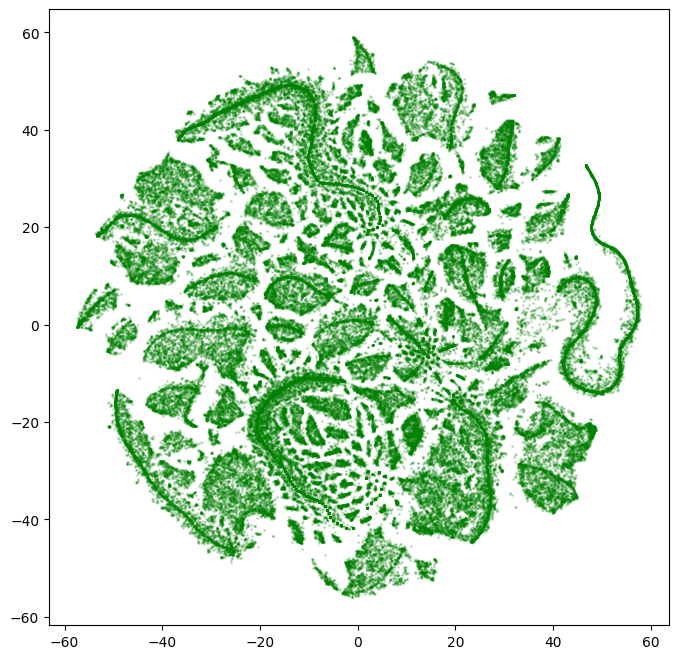

In [24]:
#### tsne per fish

colors = ['b','r','g']
# plt.figure(figsize=(12,8))
count = 0
for f in [59,63,71]:
    temp = np.where(fish_id==f)[0]

    plt.figure(figsize=(8,8))
    plt.scatter(tsne_results[temp,0],tsne_results[temp,1], c=colors[count], alpha = 0.2,s=1)

#     plt.colorbar()
    count = count + 1

    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/TSNE_f{}.svg'.format(f),transparent=True, dpi=300)


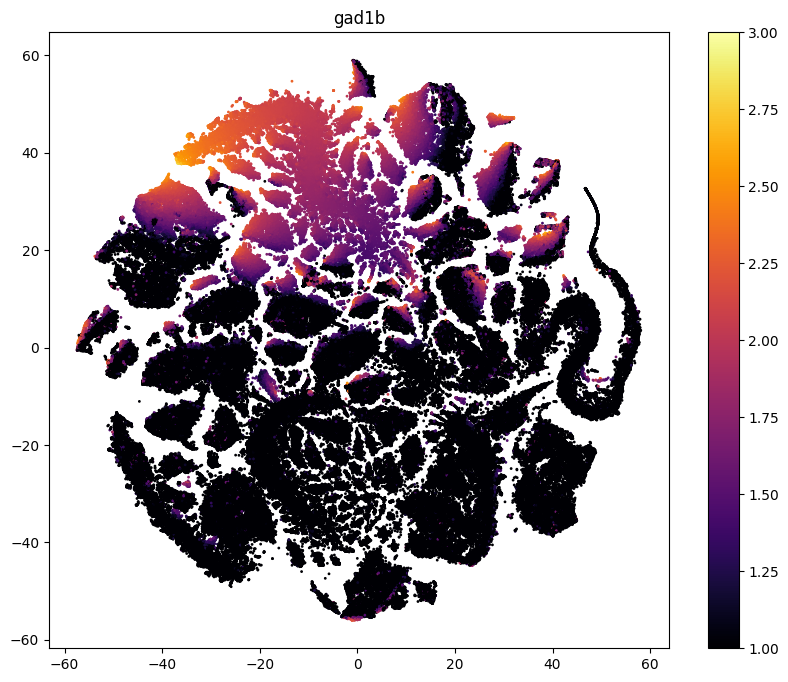

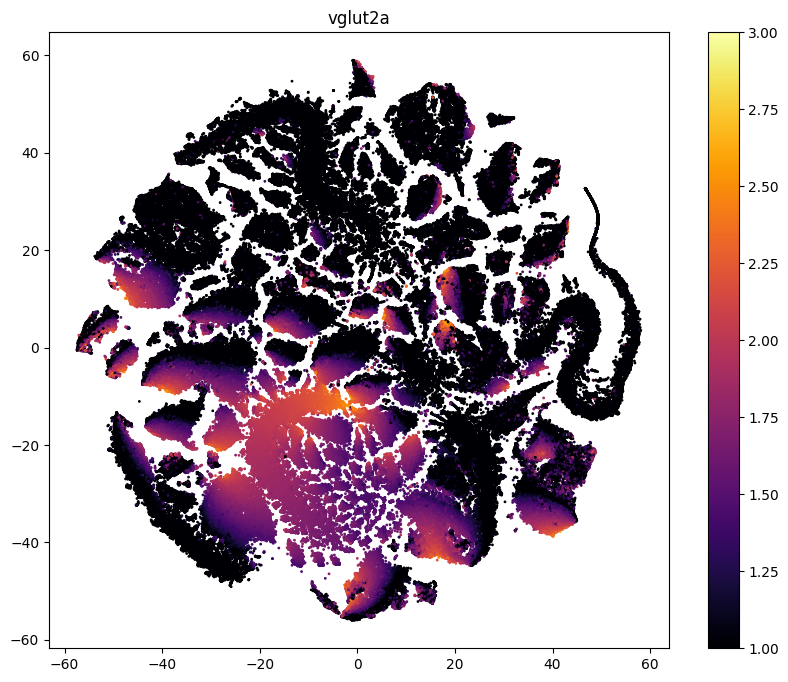

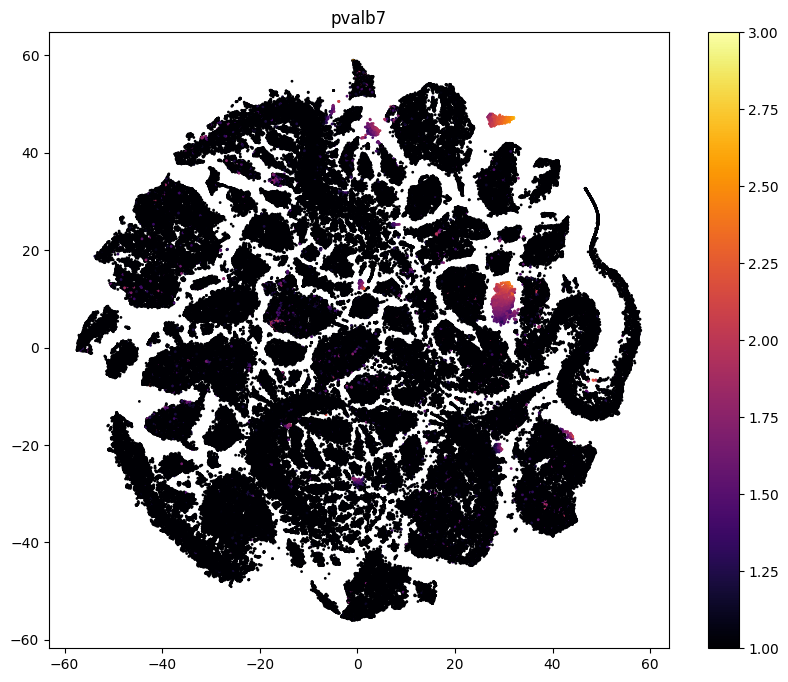

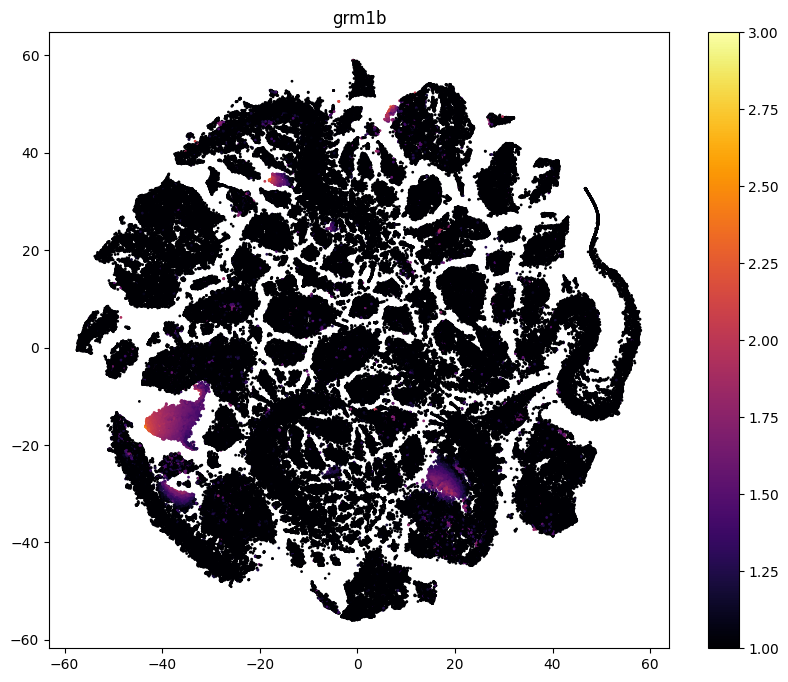

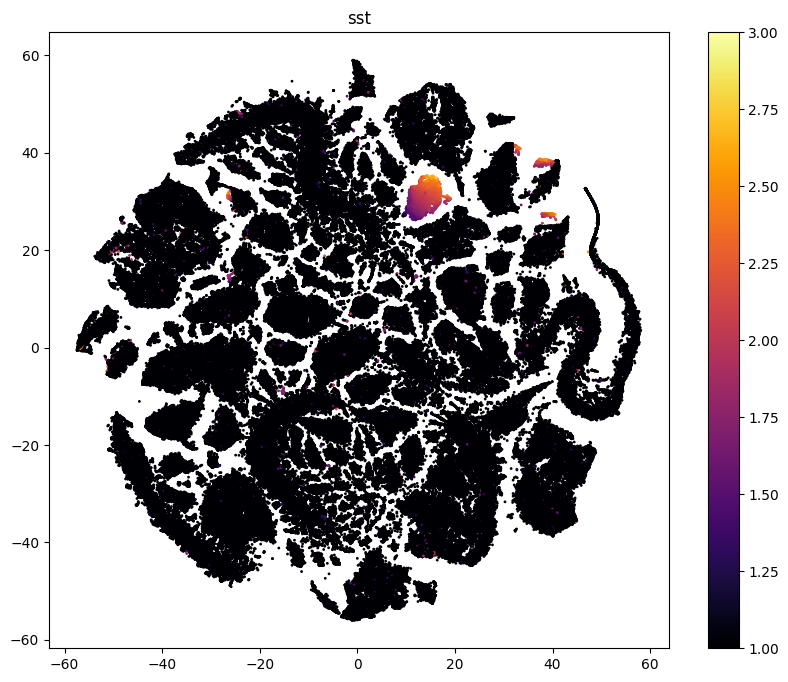

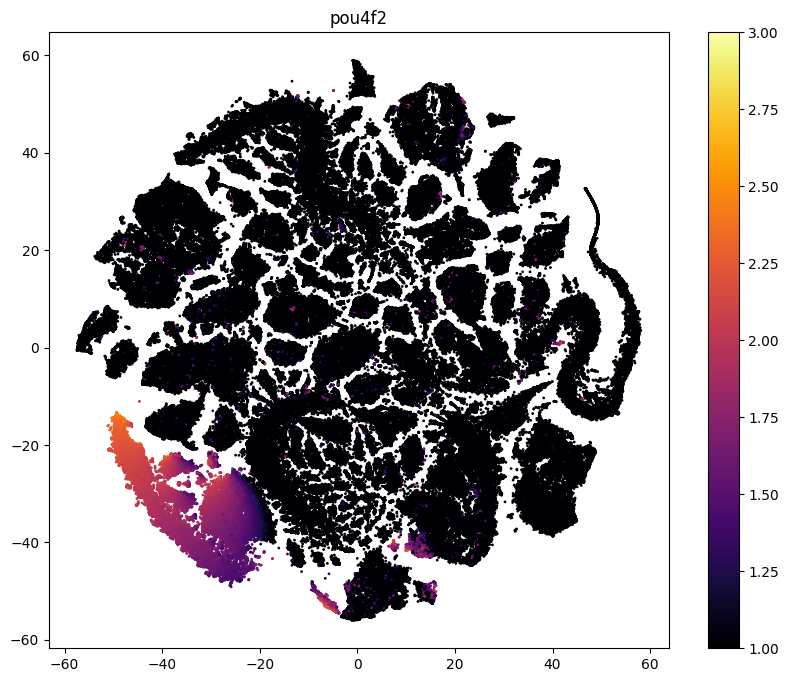

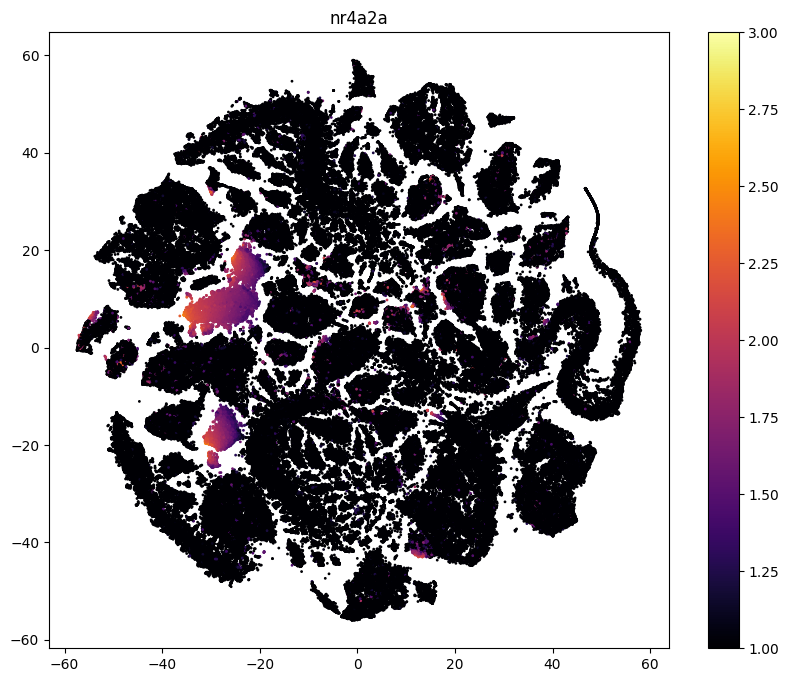

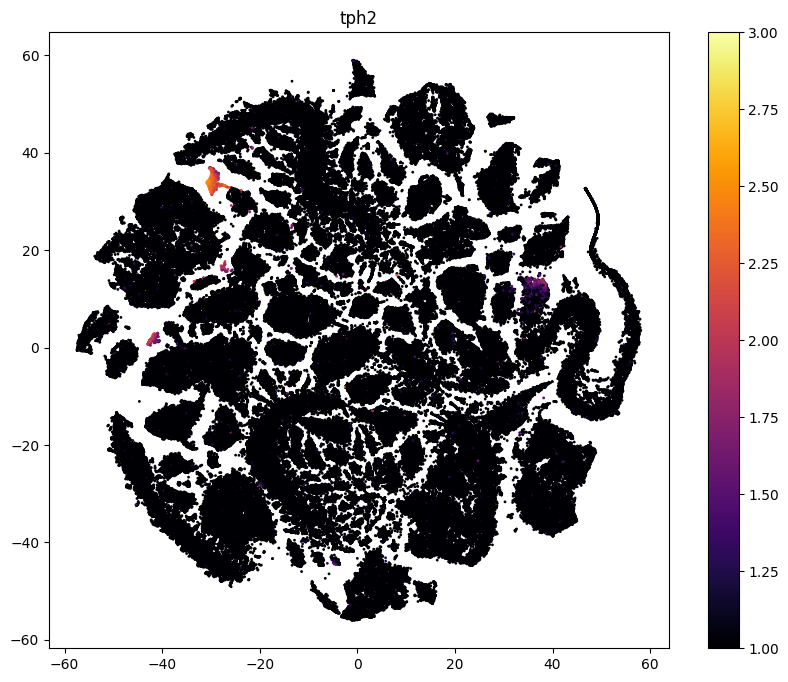

In [24]:
#### tsne with spot counts 

# for g in range(len(gene_names)):
for g in [15,17,3, 5, 18, 20, 22, 24]:
# for g in [24]:
    plt.figure(figsize=(10,8))

    plt.scatter(tsne_results[:,0],tsne_results[:,1], c = np.log10(genes_df_All[:,g]+1), cmap='inferno', alpha = 1,s=1, vmin=1, vmax=3)

    plt.colorbar()
    plt.title(gene_names[g])
    plt.clim([1,3])
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/TSNE_spots_{}.png'.format(gene_names[g]),transparent=True, dpi=300)


(-63.188354110717775,
 63.855292892456056,
 -61.746296119689944,
 64.7430498123169)

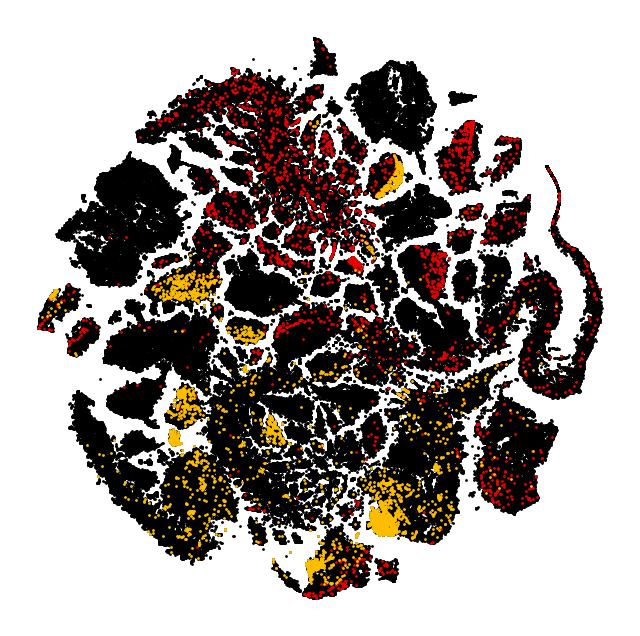

In [25]:
#### tsne with brain regions labeled

plt.figure(figsize=(8,8))
plt.scatter(tsne_results[:,0],tsne_results[:,1], c='k', alpha = 1,s=1)
# plt.title('brain regions')

b = BrainRegions_names.tolist().index('ventral_telencephalon_(subpallium)')
temp = np.where(BrainRegions_All[:,b])
plt.scatter(tsne_results[temp,0],tsne_results[temp,1], alpha = 1,s=1,c=colors_B[np.where(GoodReg==b)[0]+1,:])

b = BrainRegions_names.tolist().index('habenula')
temp = np.where(BrainRegions_All[:,b])
plt.scatter(tsne_results[temp,0],tsne_results[temp,1], alpha = 1,s=1, c=colors_B[np.where(GoodReg==b)[0]+1,:])


plt.axis('off')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/TSNE_brain_reg1.png',transparent=True, dpi=300)



(-63.188354110717775,
 63.855292892456056,
 -61.746296119689944,
 64.7430498123169)

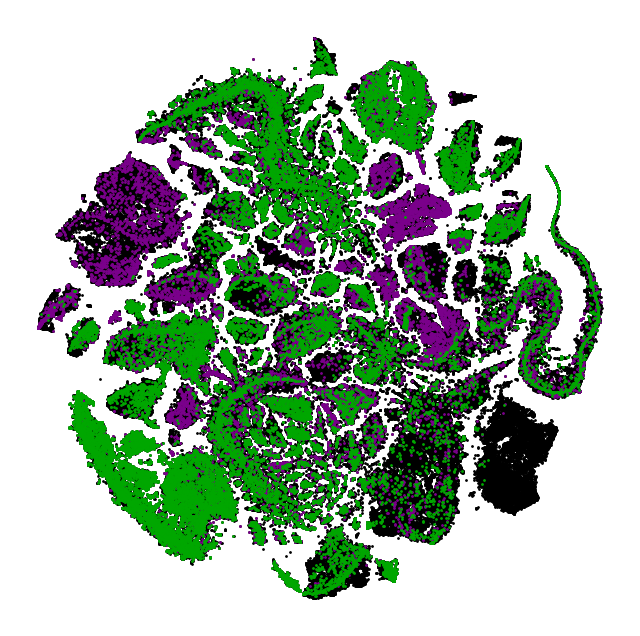

In [26]:


plt.figure(figsize=(8,8))
plt.scatter(tsne_results[:,0],tsne_results[:,1], c='k', alpha = 1,s=1)
# plt.title('brain regions')

b = BrainRegions_names.tolist().index('inferior_medulla_oblongata')
temp = np.where(BrainRegions_All[:,b])
plt.scatter(tsne_results[temp,0],tsne_results[temp,1], alpha = 1,s=1,c=colors_B[np.where(GoodReg==b)[0]+1,:])

b = BrainRegions_names.tolist().index('periventricular_layer')
temp = np.where(BrainRegions_All[:,b])
plt.scatter(tsne_results[temp,0],tsne_results[temp,1], alpha = 1,s=1, c=colors_B[np.where(GoodReg==b)[0]+1,:])


plt.axis('off')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/TSNE_brain_reg2.png',transparent=True, dpi=300)


(-63.188354110717775,
 63.855292892456056,
 -61.746296119689944,
 64.7430498123169)

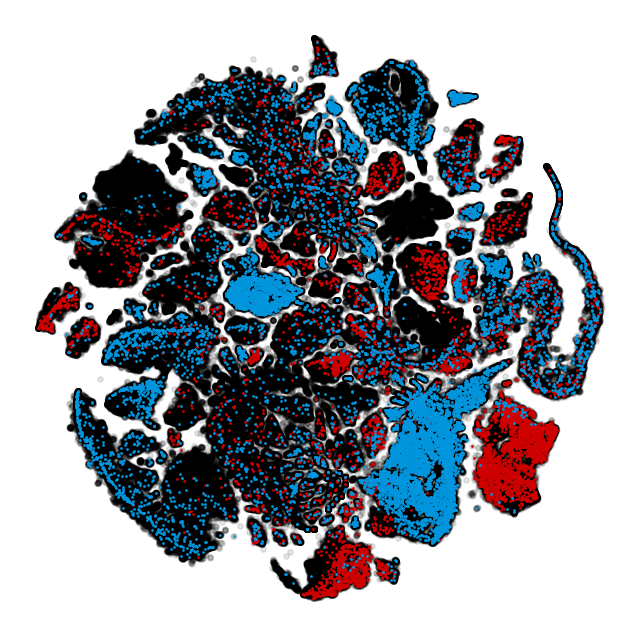

In [27]:


plt.figure(figsize=(8,8))
plt.scatter(tsne_results[:,0],tsne_results[:,1], c='k', alpha = 0.1,s=15)
# plt.title('brain regions')

b = BrainRegions_names.tolist().index('dorsal_telencephalon_(pallium)')
temp = np.where(BrainRegions_All[:,b])
plt.scatter(tsne_results[temp,0],tsne_results[temp,1], alpha = 1,s=1,c=colors_B[np.where(GoodReg==b)[0]+1,:])

b = BrainRegions_names.tolist().index('cerebellum')
temp = np.where(BrainRegions_All[:,b])
plt.scatter(tsne_results[temp,0],tsne_results[temp,1], alpha = 1,s=1, c=colors_B[np.where(GoodReg==b)[0]+1,:])


plt.axis('off')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/TSNE_brain_reg3.png',transparent=True, dpi=300)


332


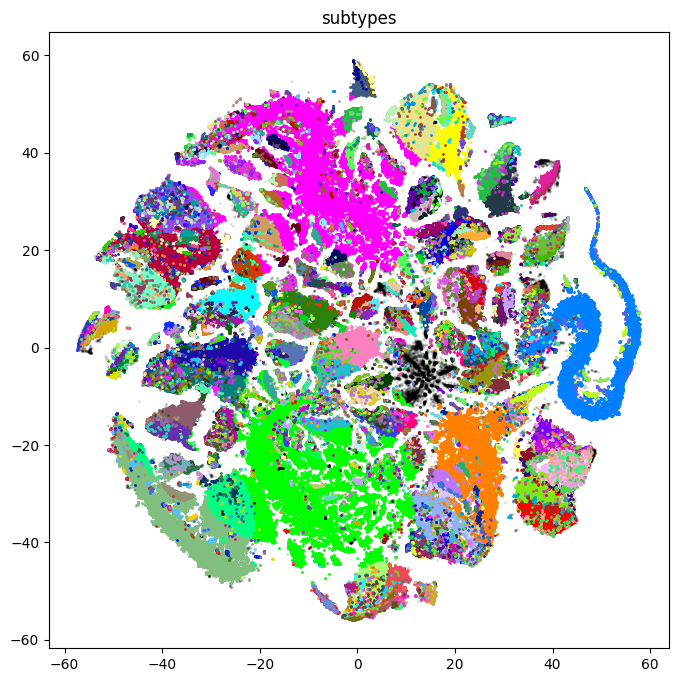

In [28]:
### tsne with the classified subtypes

plt.figure(figsize=(8,8))

plt.scatter(tsne_results[:,0],tsne_results[:,1], c = 'k', alpha = 0.1,s=1)

count = 0
for cl in np.unique(cluster_labelsAll3[np.where(cluster_labelsAll3>0)[0]]):
    temp = np.where(cluster_labelsAll3==cl)[0]
    if len(temp)>20:
        temp2 = fish_id[temp]
        if len(np.unique(temp2)) > 2: #### 
            if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:
                           
                plt.scatter(tsne_results[temp,0],tsne_results[temp,1], alpha = 1,s=1,c=colors_All[cl-1])
                count = count+1

plt.title('subtypes')


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/TSNE_subtypes.png',transparent=True, dpi=300)

print(count)

In [29]:
##########

In [30]:
#### telencephalic parvalbumin+eomesa neurons

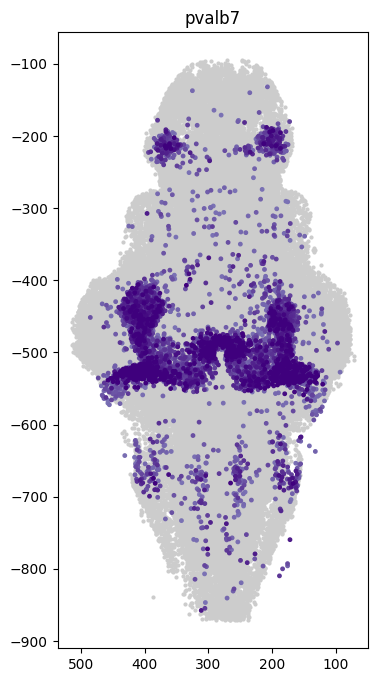

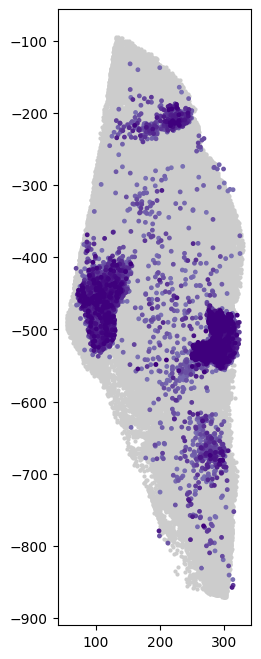

In [31]:

tempf1 = np.where(fish_id == 59)[0]

for g in [genes_sorted[25]]:
    temp = np.where(BinaryGenes_All[:,g])[0]
    # temp2 = np.where(BinaryGenes_All[:,genes_sorted[19]])[0]
    # temp = np.intersect1d(temp,temp2)

    idx2 = np.argsort(genes_df_All[temp,g])
    
    plt.figure(figsize=(4,8))
    plt.scatter(Coords_All[tempf1,1],Coords_All[tempf1,2]*-1,s=4,c='0.8',alpha=1)
    plt.scatter(Coords_All[temp[idx2],1],Coords_All[temp[idx2],2]*-1,s=6,c=np.log(genes_df_All[temp[idx2],g]+1),cmap='Purples',alpha=1,vmin=0,vmax=5)
    plt.title(gene_names[g])
    plt.gca().invert_xaxis()  # Invert the x-axis

    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Map_pvalb_top.png',transparent=True, dpi=300)

    plt.figure(figsize=(2.5,8))
    plt.scatter(Coords_All[tempf1,0],Coords_All[tempf1,2]*-1,s=4,c='0.8',alpha=1)
    plt.scatter(Coords_All[temp[idx2],0],Coords_All[temp[idx2],2]*-1,s=6,c=np.log(genes_df_All[temp[idx2],g]+1),cmap='Purples',alpha=1,vmin=0,vmax=5)

    # plt.colorbar()

    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Map_pvalb_side.png',transparent=True, dpi=300)

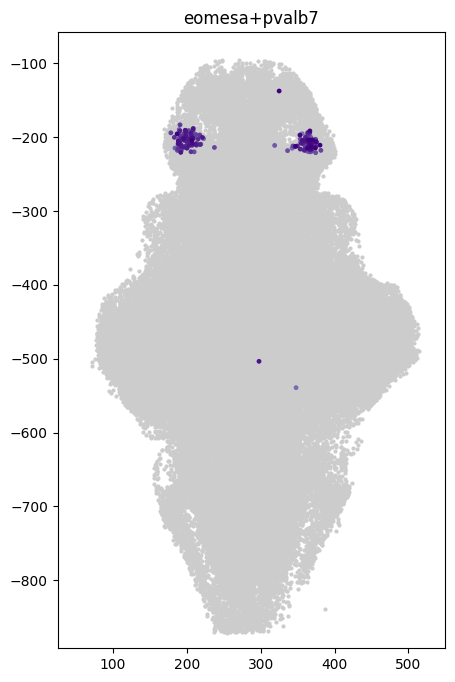

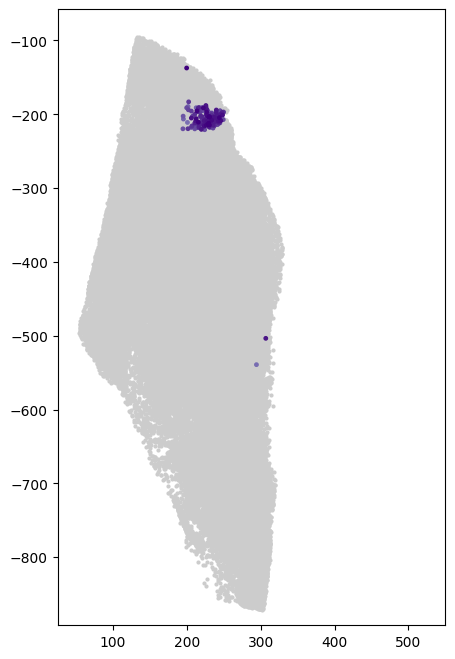

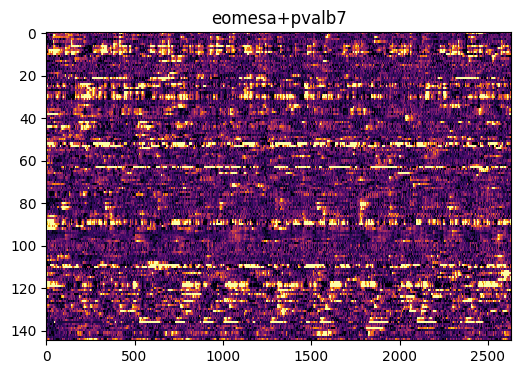

In [25]:

no_nans = np.where(~np.isnan(dff_traceAll[:,0]))[0]
in_planeAll_idx = np.where(in_planeAll)[0]

good_cells = np.intersect1d(no_nans, in_planeAll_idx)

tempf1 = np.where(fish_id==59)[0]

# for g in range(BinaryGenes_All.shape[1]): 
for g in [genes_sorted[19]]:
    g2 = 25  ### 19 is eomesa, 35 is emx3, 25 is pvalb, 
    temp = np.where(BinaryGenes_All[:,g])[0]

    temp = np.intersect1d(temp,good_cells)

    
    temp2 = np.where(BinaryGenes_All[:,genes_sorted[g2]])[0]
    temp = np.intersect1d(temp,temp2)

    idx2 = np.argsort(genes_df_All[temp,g])
    # idx2 = idx2[::-1]
    
    plt.figure(figsize=(5,8))
    plt.scatter(Coords_All[tempf1,1],Coords_All[tempf1,2]*-1,s=4,c='0.8',alpha=1)
    plt.scatter(Coords_All[temp[idx2],1],Coords_All[temp[idx2],2]*-1,s=6,c=np.log(genes_df_All[temp[idx2],g]+1),cmap='Purples',alpha=1,vmin=0,vmax=5)
    plt.title(gene_names[g]+'+'+gene_names[genes_sorted[g2]])
    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(-900, -50)  # Set y-axis limits
    
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Map_pvalb_top.png',transparent=True, dpi=300) 

    plt.figure(figsize=(5,8))
    plt.scatter(Coords_All[tempf1,0],Coords_All[tempf1,2]*-1,s=4,c='0.8',alpha=1)
    plt.scatter(Coords_All[temp[idx2],0],Coords_All[temp[idx2],2]*-1,s=6,c=np.log(genes_df_All[temp[idx2],g]+1),cmap='Purples',alpha=1,vmin=0,vmax=5)
    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(-900, -50)  # Set y-axis limits
    
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Map_pvalb_side.png',transparent=True, dpi=300)

    # plt.colorbar()


    corrmat = np.corrcoef(dff_traceAll[temp,:])
    corrmat[np.isnan(corrmat)] = 0
    
    _, idx_temp = cluster_corr(corrmat)
    plt.figure(figsize=(6,4))
    plt.imshow(dff_traceAll[temp[idx_temp],:], vmin=-0.1, vmax=0.8,cmap='inferno',aspect='auto',interpolation='nearest')
    plt.title(gene_names[g]+'+'+gene_names[genes_sorted[g2]])
    # plt.colorbar()

    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/raster_eomesaNpvalb.svg',transparent=True, dpi=300)
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/raster_eomesaNpvalb_colorbar.svg',transparent=True, dpi=300)
    np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/raster_eomesaNpvalb.csv", dff_traceAll[temp[idx_temp],:], delimiter=",")


    

In [33]:
#################

In [34]:


#### fish 1
temp59 = np.where(fish_id == 59)[0]

temp_Gmeans59 = np.zeros((genes_df_All.shape[1]))
temp_Gstd59 = np.zeros((genes_df_All.shape[1]))
temp_Gsem59 = np.zeros((genes_df_All.shape[1]))

temp_cells59 = np.zeros((genes_df_All.shape[1]))

for i in range(genes_df_All.shape[1]):
    
    temp=np.where(BinaryGenes_All[:,i])[0]

    temp = np.intersect1d(temp,temp59)

    temp_Gmeans59[i] = np.mean(genes_df_All[temp,i])
    temp_Gstd59[i] = np.std(genes_df_All[temp,i])
    temp_Gsem59[i] = stats.sem(genes_df_All[temp,i])
    
    temp_cells59[i] = len(temp)

#### fish 2
temp63 = np.where(fish_id == 63)[0]

temp_Gmeans63 = np.zeros((genes_df_All.shape[1]))
temp_Gstd63 = np.zeros((genes_df_All.shape[1]))
temp_Gsem63 = np.zeros((genes_df_All.shape[1]))

temp_cells63 = np.zeros((genes_df_All.shape[1]))

for i in range(genes_df_All.shape[1]):
    
    temp=np.where(BinaryGenes_All[:,i])[0]

    temp = np.intersect1d(temp,temp63)

    temp_Gmeans63[i] = np.mean(genes_df_All[temp,i])
    temp_Gstd63[i] = np.std(genes_df_All[temp,i])
    temp_Gsem63[i] = stats.sem(genes_df_All[temp,i])
    
    temp_cells63[i] = len(temp)

#### fish 3 
temp71 = np.where(fish_id == 71)[0]

temp_Gmeans71 = np.zeros((genes_df_All.shape[1]))
temp_Gstd71 = np.zeros((genes_df_All.shape[1]))
temp_Gsem71 = np.zeros((genes_df_All.shape[1]))

temp_cells71 = np.zeros((genes_df_All.shape[1]))

for i in range(genes_df_All.shape[1]):
    
    temp=np.where(BinaryGenes_All[:,i])[0]

    temp = np.intersect1d(temp,temp71)

    temp_Gmeans71[i] = np.mean(genes_df_All[temp,i])
    temp_Gstd71[i] = np.std(genes_df_All[temp,i])
    temp_Gsem71[i] = stats.sem(genes_df_All[temp,i])
    
    temp_cells71[i] = len(temp)

    

Text(0.5, 1.0, 'number of positive cells')

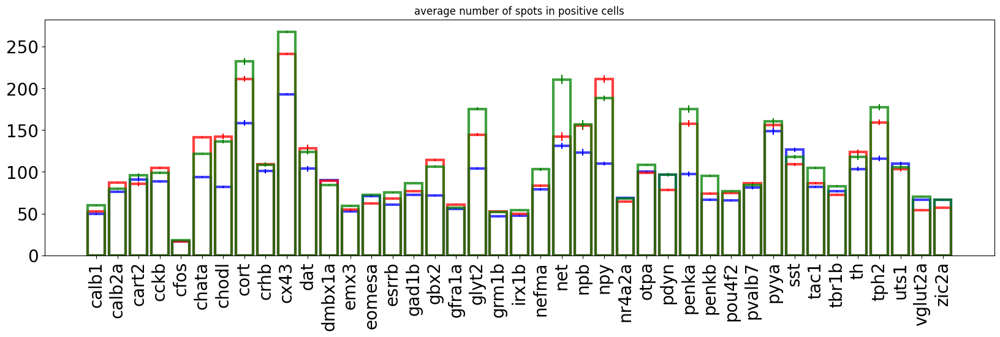

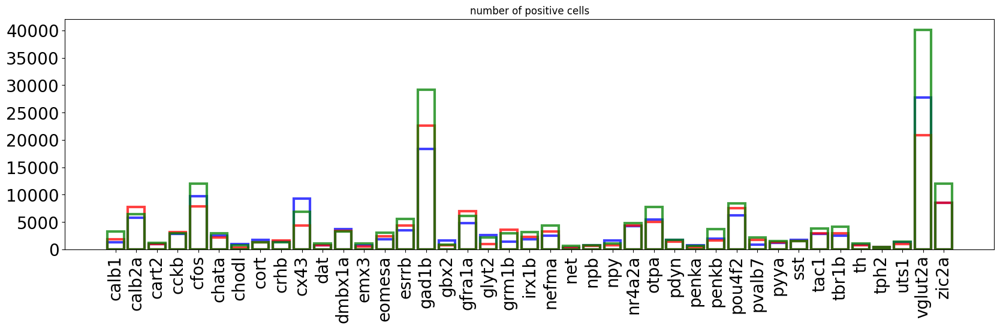

In [35]:
##### 


gene_names_sorted_abc = np.argsort(gene_names)

plt.figure(figsize=[20,5])
plt.bar(np.array(gene_names)[gene_names_sorted_abc], temp_Gmeans59[gene_names_sorted_abc], color='b', edgecolor='b', yerr=temp_Gsem59[gene_names_sorted_abc], ecolor='b', alpha=0.75, fill=False, linewidth = 3)
plt.bar(np.array(gene_names)[gene_names_sorted_abc], temp_Gmeans63[gene_names_sorted_abc], color='r', edgecolor='r', yerr=temp_Gsem63[gene_names_sorted_abc], ecolor='r', alpha=0.75, fill=False, linewidth = 3)
plt.bar(np.array(gene_names)[gene_names_sorted_abc], temp_Gmeans71[gene_names_sorted_abc], color='g', edgecolor='g', yerr=temp_Gsem71[gene_names_sorted_abc], ecolor='g', alpha=0.75, fill=False, linewidth = 3)

plt.yticks(fontsize=20)
plt.xticks(range(len(gene_names)),np.array(gene_names)[gene_names_sorted_abc], rotation = 90, fontsize=20)
plt.title('average number of spots in positive cells')


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/genes_bars_avgSpots_300dpi.svg',transparent=True, dpi=300)

plt.figure(figsize=[20,5])
plt.bar(np.array(gene_names)[gene_names_sorted_abc], temp_cells59[gene_names_sorted_abc], color='b', edgecolor='b', alpha=0.75, fill=False, linewidth = 3)
plt.bar(np.array(gene_names)[gene_names_sorted_abc], temp_cells63[gene_names_sorted_abc], color='r', edgecolor='r', alpha=0.75, fill=False, linewidth = 3)
plt.bar(np.array(gene_names)[gene_names_sorted_abc], temp_cells71[gene_names_sorted_abc], color='g', edgecolor='g', alpha=0.75, fill=False, linewidth = 3)
plt.xticks(range(len(gene_names)),np.array(gene_names)[gene_names_sorted_abc], rotation = 90, fontsize=20)
plt.yticks(fontsize=20)
# plt.ylim([0,35000])
plt.title('number of positive cells')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/genes_bars_avgCells_300dpi.svg',transparent=True, dpi=300)

In [36]:
print(gene_names.index('pvalb7'),
gene_names.index('grm1b'),
gene_names.index('sst'),
gene_names.index('pou4f2'),
gene_names.index('nr4a2a'),
gene_names.index('tph2')
     )

3 5 18 20 22 24


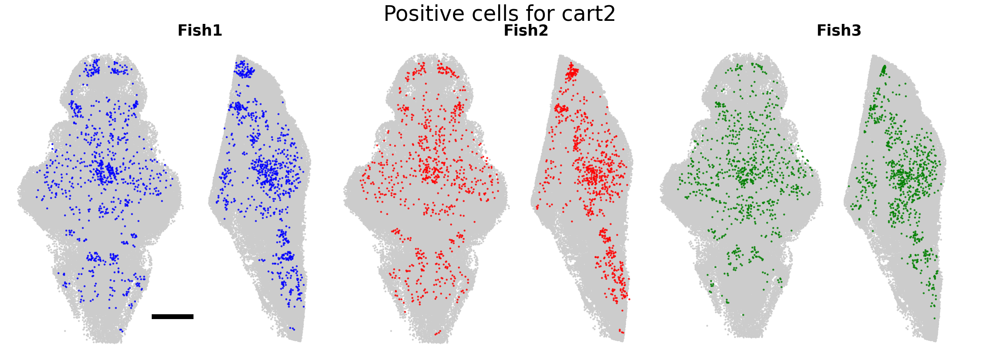

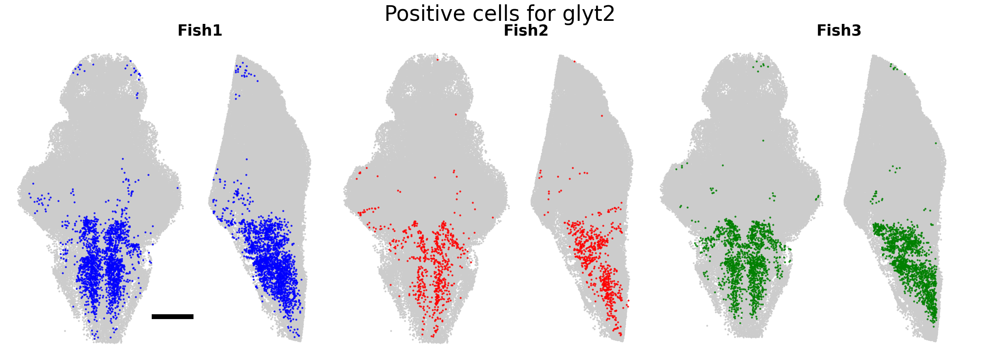

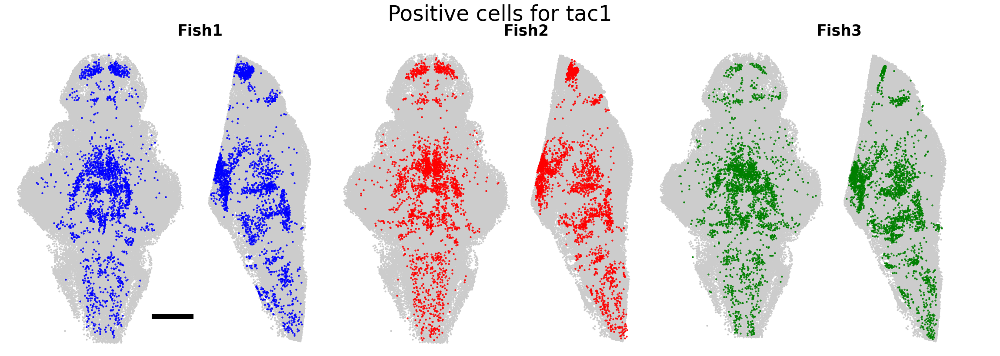

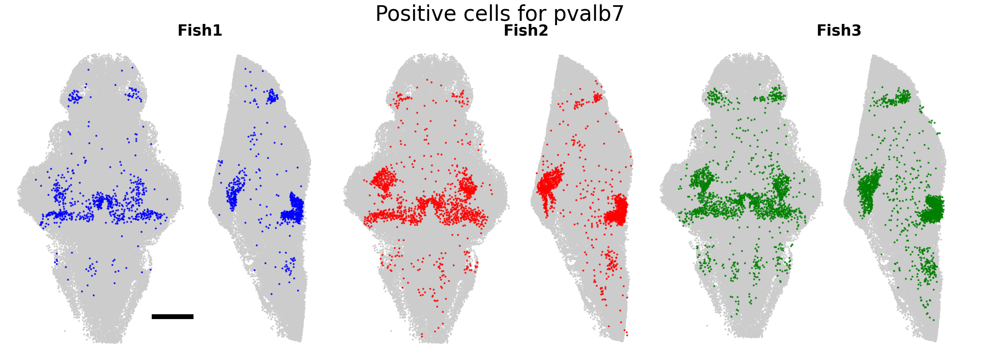

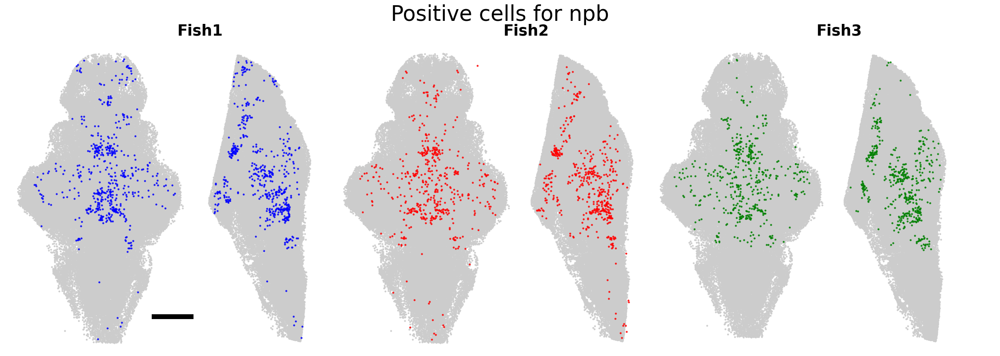

...

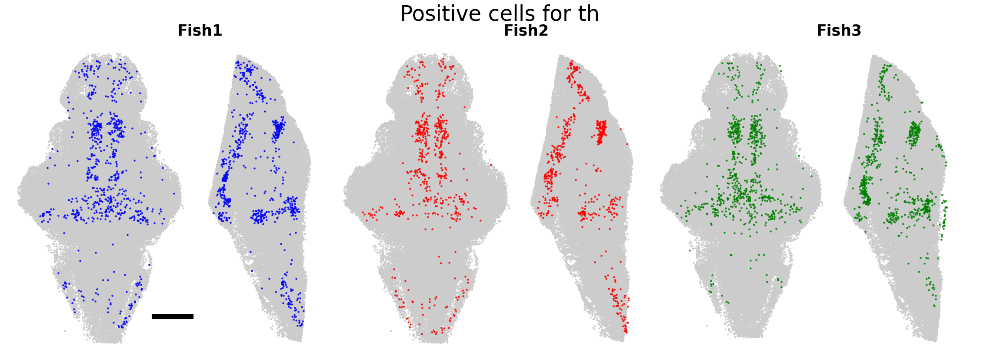

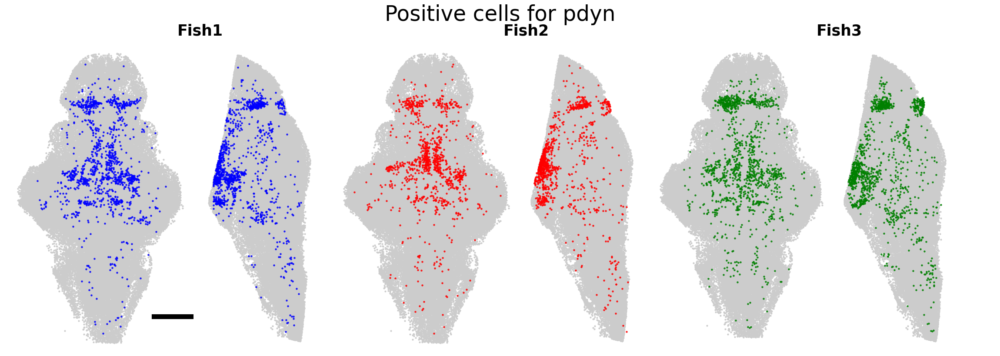

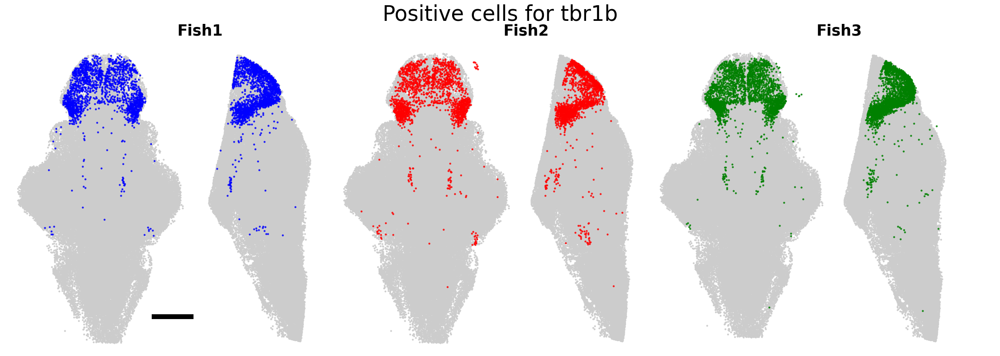

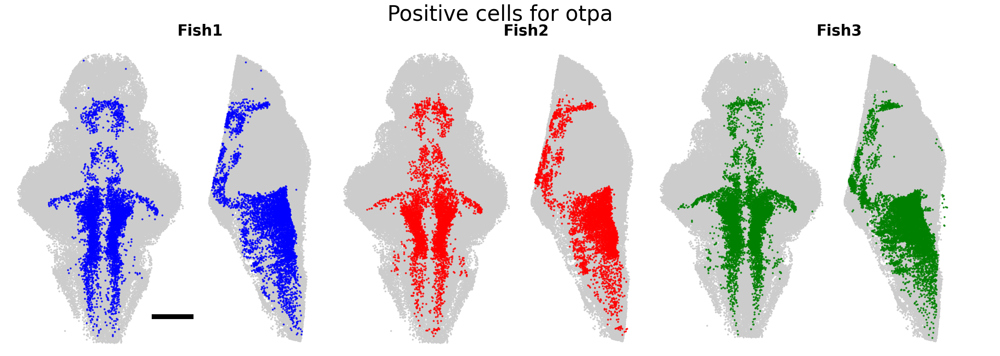

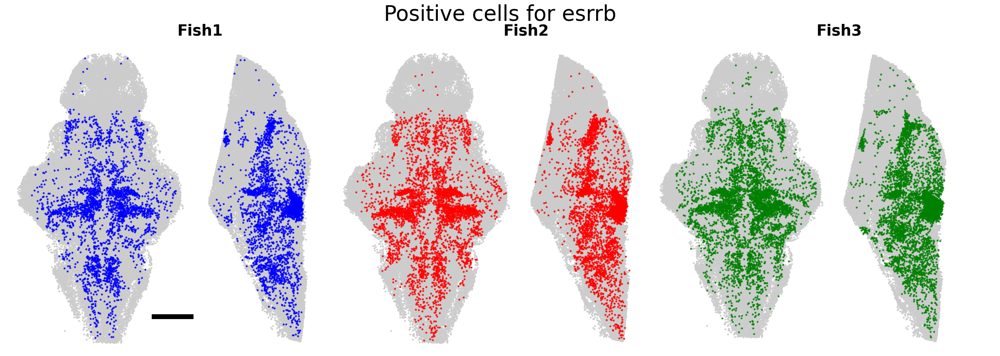

In [37]:
from matplotlib.gridspec import GridSpec
from matplotlib.transforms import Bbox

#### both views of some selected genes and saving as a .png

tempf1 = np.where(fish_id == 59)[0]

for i in range(genes_df_All.shape[1]): 

    tempf = np.where(fish_id == 59)[0]

    temp1 = np.where(np.max(BrainRegions_All,1))[0]  #### for within the brain
    temp2=np.where(BinaryGenes_All[:,i])[0] #### with just gene filter
    temp2 = np.intersect1d(temp1,temp2)
    temp2 = np.intersect1d(tempf,temp2)

    ###### making the figure
    fig = plt.figure(figsize=(30, 8))
    
    # Set the figure background color to white
    fig.patch.set_facecolor('white')
    
    # Create a GridSpec layout
    gs = GridSpec(1, 6, width_ratios=[1, 1, 1, 1, 1, 1])  # Two rows, first row twice the height of the second
            
    # Create subplots using GridSpec
    ax1 = fig.add_axes([0.12, 0., 0.15, 0.9], facecolor='none')  # First subplot
    ax2 = fig.add_axes([0.25, 0., 0.15, 0.9], facecolor='none')  # Second subplot
    ax3 = fig.add_axes([0.37, 0., 0.15, 0.9], facecolor='none')  # Third subplot
    ax4 = fig.add_axes([0.49, 0., 0.15, 0.9], facecolor='none')  # First subplot
    ax5 = fig.add_axes([0.61, 0., 0.15, 0.9], facecolor='none')  # Second subplot
    ax6 = fig.add_axes([0.73, 0., 0.15, 0.9], facecolor='none')  # Third subplot
    
    
    ax1.scatter(Coords_All[tempf1,1],Coords_All[tempf1,2]*-1,s=4,c='0.8',alpha=1)
    ax1.scatter(Coords_All[temp2,1],Coords_All[temp2,2]*-1,s=5,alpha=0.8,c='b')
    ax1.set_title('Fish1', fontdict={'fontsize': 25, 'fontweight': 'bold',},x=1)
    ax1.axis('equal')
    ax1.set_xlim(25, 550)  # Set x-axis limits
    ax1.set_ylim(-900, -50)  # Set y-axis limits
    ax1.axis('off')
    ax1.plot(np.arange(50,150),np.ones(100)*-800, c='k',linewidth=8)
    ax1.invert_xaxis()  # Invert the x-axis
    
    ax2.scatter(Coords_All[tempf1,0],Coords_All[tempf1,2]*-1,s=4,c='0.8',alpha=1)
    ax2.scatter(Coords_All[temp2,0],Coords_All[temp2,2]*-1,s=5,alpha=0.8,c='b')
    # ax2.set_title('Fish1 '+gene_names[i], fontdict={'fontsize': 16, 'fontweight': 'bold',})
    ax2.axis('equal')
    ax2.set_xlim(50, 400)  # Set x-axis limits
    ax2.set_ylim(-900, -50)  # Set y-axis limits
    ax2.axis('off')
    
    
    ax3.scatter(Coords_All[tempf1,1],Coords_All[tempf1,2]*-1,s=4,c='0.8',alpha=1)
    
    tempf = np.where(fish_id == 63)[0]
    temp1 = np.where(np.max(BrainRegions_All,1))[0]  #### for within the brain
    temp2=np.where(BinaryGenes_All[:,i])[0] #### with just gene filter
    temp2 = np.intersect1d(temp1,temp2)
    temp2 = np.intersect1d(tempf,temp2)
    
    
    ax3.scatter(Coords_All[temp2,1],Coords_All[temp2,2]*-1,s=5,alpha=0.8,c='r')
    ax3.set_title('Fish2', fontdict={'fontsize': 25, 'fontweight': 'bold',},x=1)
    ax3.axis('equal')
    ax3.set_xlim(25, 550)  # Set x-axis limits
    ax3.set_ylim(-900, -50)  # Set y-axis limits
    ax3.axis('off')
    ax3.invert_xaxis()  # Invert the x-axis
    
    ax4.scatter(Coords_All[tempf1,0],Coords_All[tempf1,2]*-1,s=4,c='0.8',alpha=1)
    ax4.scatter(Coords_All[temp2,0],Coords_All[temp2,2]*-1,s=5,alpha=0.8,c='r')
    # ax4.set_title('Fish2 '+gene_names[i], fontdict={'fontsize': 16, 'fontweight': 'bold',})
    ax4.axis('equal')
    ax4.set_xlim(0, 400)  # Set x-axis limits
    ax4.set_ylim(-900, -50)  # Set y-axis limits
    ax4.axis('off')
    
    ax5.scatter(Coords_All[tempf1,1],Coords_All[tempf1,2]*-1,s=4,c='0.8',alpha=1)
    
    tempf = np.where(fish_id == 71)[0]
    temp1 = np.where(np.max(BrainRegions_All,1))[0]  #### for within the brain
    temp2=np.where(BinaryGenes_All[:,i])[0] #### with just gene filter
    temp2 = np.intersect1d(temp1,temp2)
    temp2 = np.intersect1d(tempf,temp2)
    
    ax5.scatter(Coords_All[temp2,1],Coords_All[temp2,2]*-1,s=5,alpha=0.8,c='g')
    ax5.set_title('Fish3', fontdict={'fontsize': 25, 'fontweight': 'bold',},x=1)
    ax5.axis('equal')
    plt.xlim(0, 400)  # Set x-axis limits
    plt.ylim(-900, -50)  # Set y-axis limits
    ax5.axis('off')
    ax5.invert_xaxis()  # Invert the x-axis
    
    ax6.scatter(Coords_All[tempf1,0],Coords_All[tempf1,2]*-1,s=4,c='0.8',alpha=1)
    ax6.scatter(Coords_All[temp2,0],Coords_All[temp2,2]*-1,s=5,alpha=0.8,c='g')
    # ax6.set_title('Fish3 '+gene_names[i], fontdict={'fontsize': 16, 'fontweight': 'bold',})
    ax6.axis('equal')
    ax6.set_xlim(0, 400)  # Set x-axis limits
    ax6.set_ylim(-900, -50)  # Set y-axis limits
    ax6.axis('off')
    
    
    # Add a title for the entire figure
    fig.suptitle('Positive cells for '+ gene_names[i], fontsize=35, y=1, x=0.5)
      
    
    plt.tight_layout()
    
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/PosCells/PosCells_gene_{}_300dpi.png'.format(gene_names[i]),transparent=True, dpi=300, bbox_inches= Bbox.from_bounds(3.4, 0, 22.5, 8.5), facecolor='white')

    

In [38]:
#########################################

In [40]:
#### using the masks of the atlas. 

import tifffile as tif 

volumes_dir = '/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/mapzebrainMasks'

bigtemp = np.zeros((359, 974, 597))
bigtemp[:] = np.nan

BrainReg_list = ['inferior_medulla_oblongata', 'intermediate_medulla_oblongata', 'superior_medulla_oblongata',
                'superior_raphe', 'cerebellum', 'tegmentum', 'nucleus_isthmi', 'periventricular_layer', 'tectal_neuropil',
                'pretectum', 'prethalamus_(ventral_thalamus)', 'dorsal_thalamus_proper', 'habenula',
                'hypothalamus', 'ventral_telencephalon_(subpallium)', 'dorsal_telencephalon_(pallium)']


for i, r in enumerate(BrainReg_list):
    
    temp = tif.imread(volumes_dir+'/'+r+'.tif')
    bigtemp[np.where(temp)] = i + 1



(900.0, 50.0)

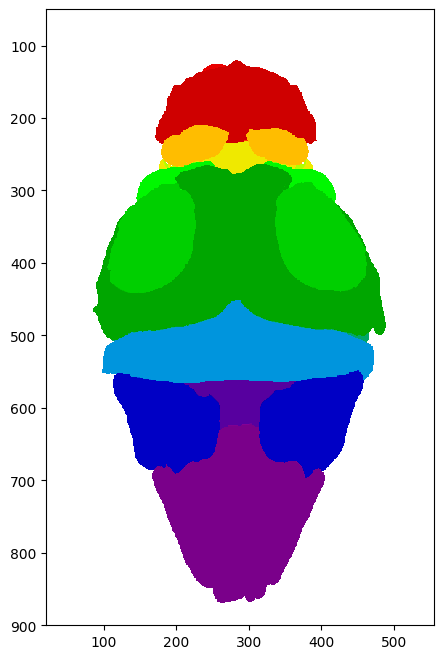

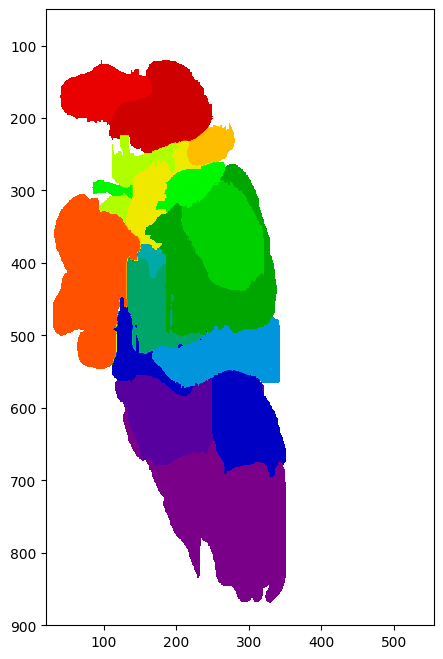

In [41]:
plt.figure(figsize=(5,8))
for z in range(0, bigtemp.shape[0], 10):
    plt.imshow(bigtemp[z,:,:], cmap='nipy_spectral', vmin=0, vmax=17, alpha = 1)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(900, 50)  # Set y-axis limits

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Atlas_BrainColors_top.svg',transparent=True, dpi=300)

plt.figure(figsize=(5,8))
for x in range(0, bigtemp.shape[2], 10):
    plt.imshow(bigtemp[:,:,x].T, cmap='nipy_spectral', vmin=0, vmax=17, alpha = 1)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(900, 50)  # Set y-axis limits

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Atlas_BrainColors_side.svg',transparent=True, dpi=300)


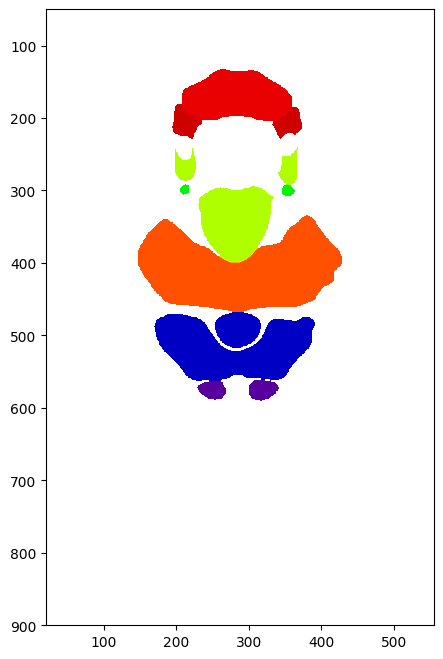

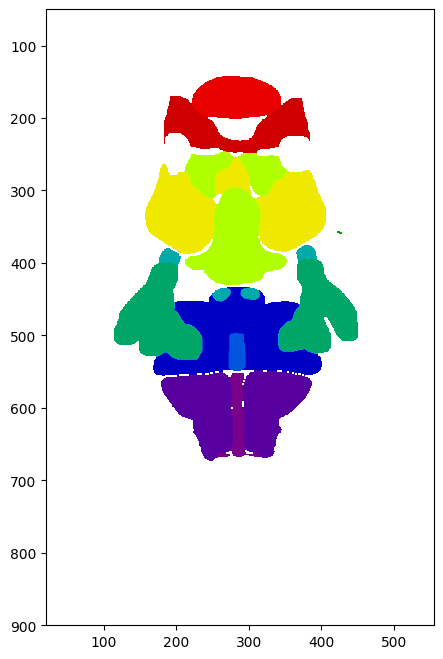

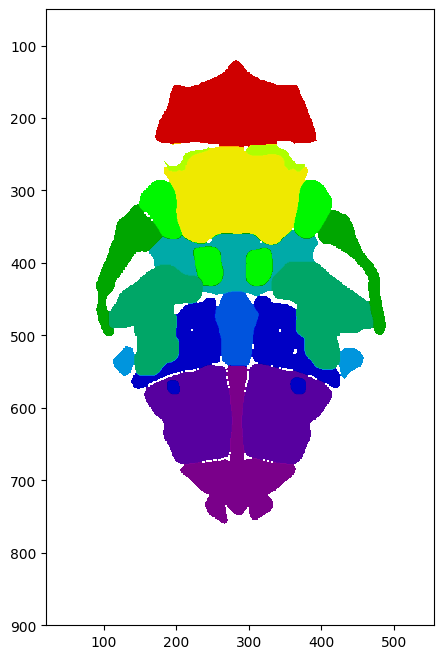

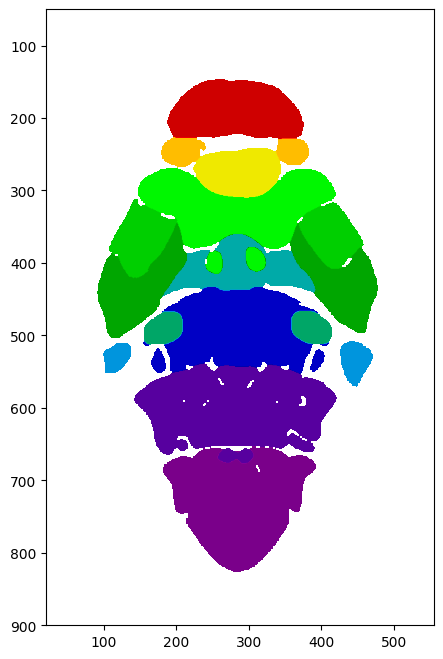

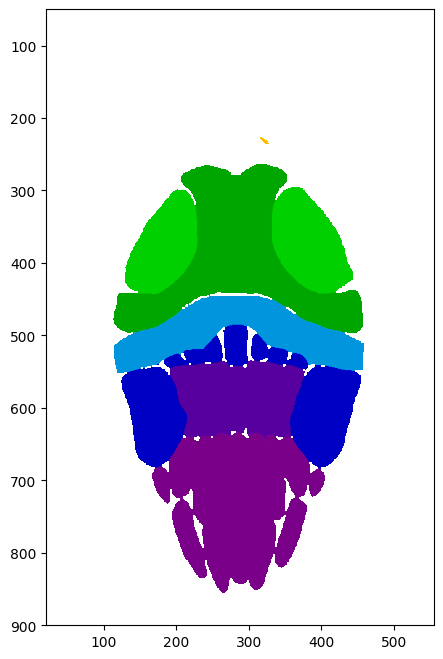

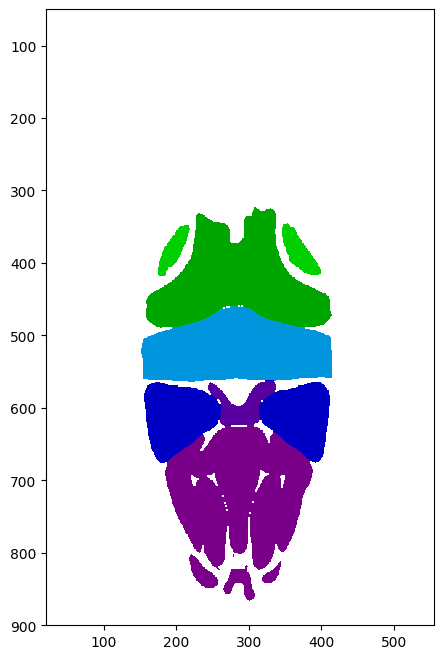

In [42]:
##### plotting brain regions at specific planes
    
for z in [120,155,190,225,280,315]:

    plt.figure(figsize=(5,8))
    plt.imshow(bigtemp[z,:,:], cmap='nipy_spectral', vmin=0, vmax=17, alpha = 1)

    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(900, 50)  # Set y-axis limits

    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Map_BrainColors_top_z{}.svg'.format(z),transparent=True, dpi=300)
       

In [43]:
#### using the masks of the atlas. 

import tifffile as tif 

volumes_dir = '/nrs/ahrens/Emmanuel/multFISH/DataForFigshare/mapzebrainMasks'

bigtemp2 = np.zeros((359, 974, 597))
bigtemp2[:] = np.nan

BrainReg_list = ['superior_medulla_oblongata',
                ]


for i, r in enumerate(BrainReg_list):
    
    temp = tif.imread(volumes_dir+'/'+r+'.tif')
    bigtemp2[np.where(temp)] = 2 + 1



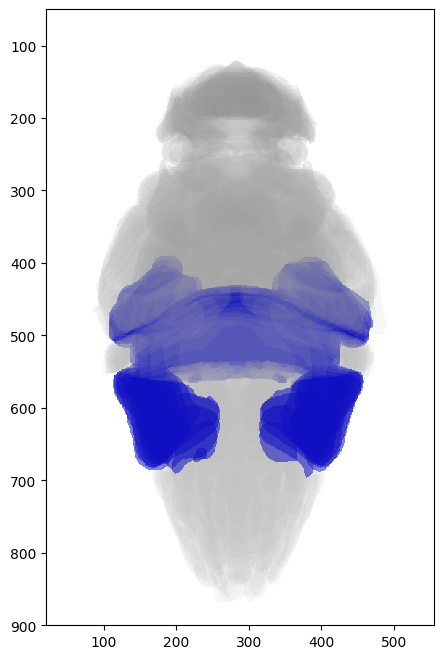

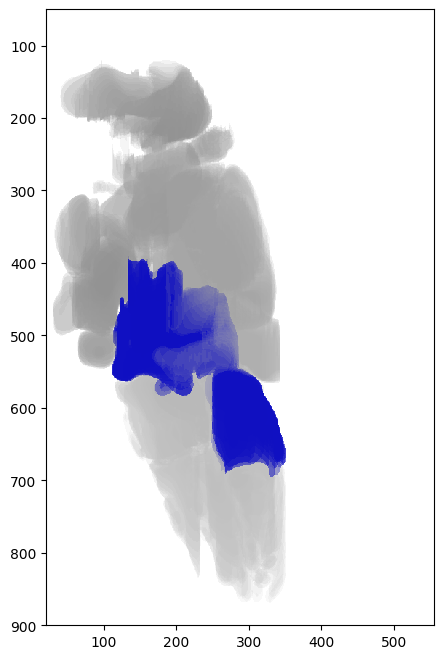

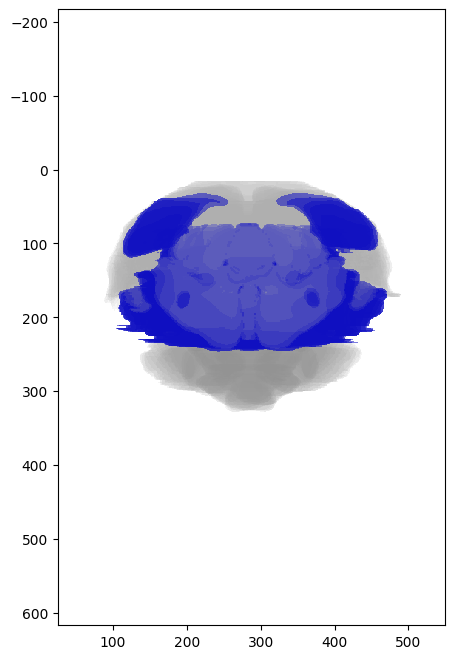

In [44]:
plt.figure(figsize=(5,8))
for z in range(0, bigtemp.shape[0], 10):
    plt.imshow(bigtemp[z,:,:], cmap='gray_r', vmin=-20, vmax=60, alpha = 0.1)
    plt.imshow(bigtemp2[z,:,:], cmap='nipy_spectral', vmin=0, vmax=17, alpha = 0.5)

    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(900, 50)  # Set y-axis limits

    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Map_BrainColors_SupMO_top.png',transparent=True, dpi=300)
    

plt.figure(figsize=(5,8))
for x in range(0, bigtemp.shape[2], 10):
    plt.imshow(bigtemp[:,:,x].T, cmap='gray_r', vmin=-20, vmax=60, alpha = 0.1)
    plt.imshow(bigtemp2[:,:,x].T, cmap='nipy_spectral', vmin=0, vmax=17, alpha = 0.5)

    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(900, 50)  # Set y-axis limits

    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Map_BrainColors_SupMO_side.png',transparent=True, dpi=300)


plt.figure(figsize=(5,8))
for y in range(0, bigtemp.shape[2], 10):
    plt.imshow(bigtemp[::-1,y,:], cmap='gray_r', vmin=-20, vmax=60, alpha = 0.1)
    plt.imshow(bigtemp2[::-1,y,:], cmap='nipy_spectral', vmin=0, vmax=17, alpha = 0.5)

    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(375, 25)  # Set y-axis limits


    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Map_BrainColors_SupMO_front.png',transparent=True, dpi=300)

(-900.0, -50.0)

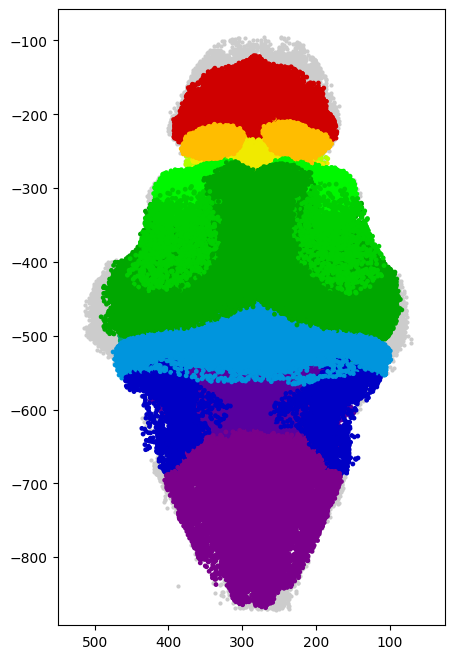

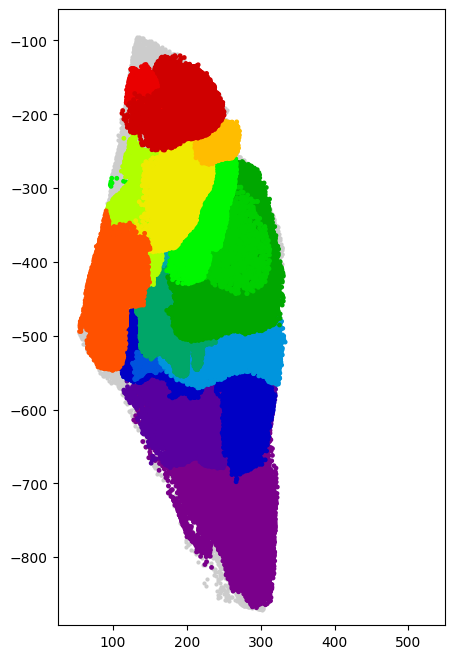

In [45]:
temp_f = np.where(fish_id==59)[0]

#### for map the brain regions
temp_All = np.zeros((1))

for j,b in enumerate(GoodReg[::-1]):

    temp_b = np.where(BrainRegions_All[:,b])[0]

    temp_All = np.hstack((temp_All, temp_b))

temp_All = temp_All[1::]

temp_Bra = Brain_reg[temp_All.astype(int)]


idx2 = np.argsort(temp_Bra)


#### top view reordered based on z
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)

idxZ = np.argsort(Coords_All[temp_All.astype(int),0])
plt.scatter(Coords_All[temp_All[idxZ].astype(int),1],Coords_All[temp_All[idxZ].astype(int),2]*-1,s=6,c=temp_Bra[idxZ], cmap='nipy_spectral',vmin=0, vmax=17)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits
plt.gca().invert_xaxis()  # Invert the x-axis

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/PosCells_BrainColors_top.png',transparent=True, dpi=300)

#### lateral view
plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,0],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)
plt.scatter(Coords_All[temp_All[idx2].astype(int),0],Coords_All[temp_All[idx2].astype(int),2]*-1,s=6,c=temp_Bra[idx2], cmap='nipy_spectral',vmin=0, vmax=17)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/PosCells_BrainColors_side.png',transparent=True, dpi=300)


In [46]:
################

In [47]:
##### making at average of the stimulus presentations (one series of 9 presentations) for each cell. (at 1Hz)


from scipy.signal import find_peaks

dff_traceAllavg = np.zeros((dff_traceAll.shape[0],134))

w_peaks, _ = find_peaks(regressors[0,::2], height=0.8, distance=10)

diffgain = np.diff(regressors[0,::2])
w_peaks2, _ = find_peaks(diffgain, height=0.8, distance=10)

for n in range(dff_traceAll.shape[0]):
    
    wind_t = np.zeros((9,134))

    for t in range(9):
        temp_trace = dff_traceAll[n,::2]
        wind_t[t,:] = temp_trace[w_peaks[t]-(9*1):w_peaks[t]+(125*1)] 

    dff_traceAllavg[n,:] = np.nanmean(wind_t,axis=0)

print(dff_traceAllavg.shape)

(306108, 134)


In [48]:
#####################

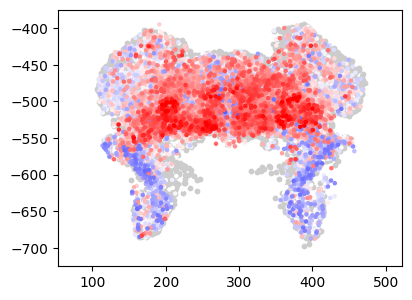

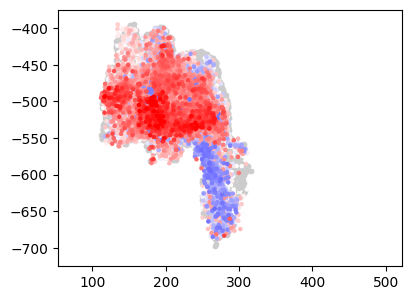

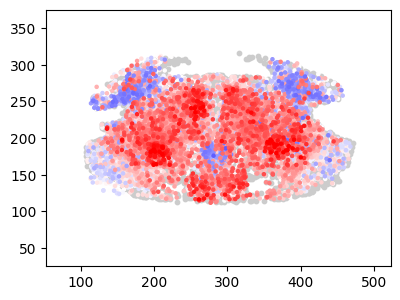

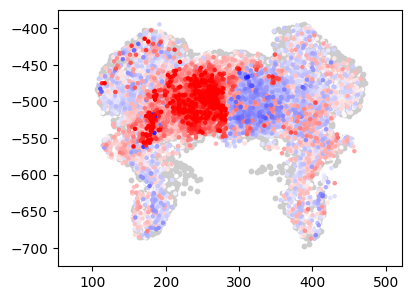

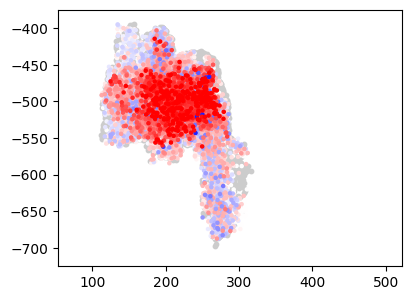

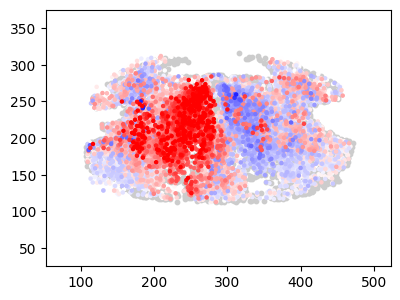

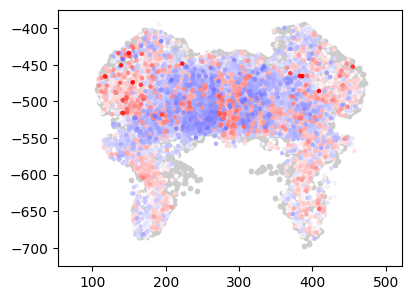

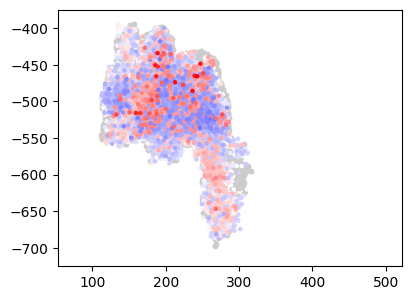

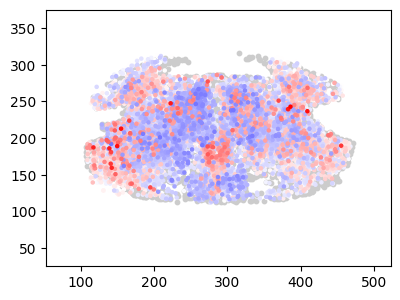

In [49]:
#### now looking at subtypes and traces in the thalamus or another particular brain region
#### to plot their correlation to stimuli or max response


minG = 2 #### minimum number of genes in a subtype

f = 59

temp_f = np.where(fish_id==f)[0]

bb = BrainRegions_names.tolist().index('superior_medulla_oblongata')
# b = BrainRegions_names.tolist().index('superior_raphe')
# bb = BrainRegions_names.tolist().index('prethalamus_(ventral_thalamus)')
# bb = BrainRegions_names.tolist().index('dorsal_thalamus_proper')
# b = BrainRegions_names.tolist().index('periventricular_layer')
# bb = BrainRegions_names.tolist().index('dorsal_telencephalon_(pallium)')
# b = BrainRegions_names.tolist().index('telencephalon')

#### selecting just a brain region
temp_ff = np.intersect1d(temp_f, np.where(BrainRegions_All[:,bb])[0])


sub_perSim_innerCorr = []


# for s in range(9):
for s in [0,2,4]:

    if s in [0,]:
        minc = -0.5
        maxc = 0.5
    if s in [1,2,3,4,5,6,7]:
        minc = -0.4
        maxc = 0.4
    if s in [9]:
        minc = -1
        maxc = 1

    plt.figure(figsize=(4/0.9,3/0.9))
    plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,2]*-1,s=10,c='0.8',alpha=1)
    
    names = ['all cells']
    
    temp_All = np.zeros((1))
    
    # for b in (GoodReg):
    for b in ([bb]):
    
        temp_f = np.where(fish_id==f)[0] 
        
        for i, cl in enumerate(list(np.unique(cluster_labelsAll3)[1::][np.where(g_in_cls>=minG)[0]])):
            
            if cl in glia_subs:
                continue
            temp = np.where(cluster_labelsAll3==cl)[0]
            # print(cl)
            
            ##### if looking at a particular brain region
            temp_b = np.where(BrainRegions_All[:,b])[0]  #### 9 = thalamus
            temp = np.intersect1d(temp,temp_b)
            
            temp2 = fish_id[temp]
        
        
            if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:
        
                if len(np.where(temp2==59)[0])/len(temp2)>0.70 or len(np.where(temp2==63)[0])/len(temp2)>0.70 or len(np.where(temp2==71)[0])/len(temp2)>0.70:
                  
                    continue
        
    
                temp_All = np.hstack((temp_All, temp))
                
                names.append(good_cls_names[np.where(g_in_cls>=minG)[0][i]])
        
    
    temp_All = temp_All[1::].astype(int)

    sub_perSim_innerCorr.append(np.unique(cluster_labelsAll3[temp_All]))
    
    
    if s<8:
        sort_idx = np.argsort(np.absolute(big_corr_regsAllMix[temp_All,s]))
    
        plt.scatter(Coords_All[temp_All[sort_idx],1],Coords_All[temp_All[sort_idx],2]*-1,s=5,alpha=1,c=big_corr_regsAllMix[temp_All[sort_idx],s],cmap='bwr',vmin=minc, vmax=maxc)
        # plt.colorbar()
    
    elif s==8:
        sort_idx2 = np.argsort(np.absolute(swim_corr_All[temp_All]))
        plt.scatter(Coords_All[temp_All[sort_idx2],1],Coords_All[temp_All[sort_idx2],2]*-1,s=5,alpha=1,c=swim_corr_All[temp_All[sort_idx2]],cmap='bwr',vmin=minc, vmax=maxc)


    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(-725, -375)  # Set y-axis limits
    
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_corr_test_top_stim_{}_300dpi.png'.format(s+1),transparent=True, dpi=300)
    
    ####### lateral view
    
    
    plt.figure(figsize=(4/0.9,3/0.9))
    plt.scatter(Coords_All[temp_ff,0],Coords_All[temp_ff,2]*-1,s=10,c='0.8',alpha=1)
    
    
    names = ['all cells']
   
        
    if s<8:
        plt.scatter(Coords_All[temp_All[sort_idx],0],Coords_All[temp_All[sort_idx],2]*-1,s=5,alpha=1,c=big_corr_regsAllMix[temp_All[sort_idx],s],cmap='bwr',vmin=minc, vmax=maxc)
    
    elif s==8:
        plt.scatter(Coords_All[temp_All[sort_idx2],0],Coords_All[temp_All[sort_idx2],2]*-1,s=5,alpha=1,c=swim_corr_All[temp_All[sort_idx2]],cmap='bwr',vmin=minc, vmax=maxc)
    

    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(-725, -375)  # Set y-axis limits
    
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_corr_test_side_stim_{}_300dpi.png'.format(s+1),transparent=True, dpi=300)
    
    ####### coronal view
    
    plt.figure(figsize=(4/0.9,3/0.9))
    plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,0],s=10,c='0.8',alpha=1)
    

    if s<8:
    
        plt.scatter(Coords_All[temp_All[sort_idx],1],Coords_All[temp_All[sort_idx],0],s=5,alpha=1,c=big_corr_regsAllMix[temp_All[sort_idx],s],cmap='bwr',vmin=minc, vmax=maxc)

    elif s==8:
        plt.scatter(Coords_All[temp_All[sort_idx2],1],Coords_All[temp_All[sort_idx2],0],s=5,alpha=1,c=swim_corr_All[temp_All[sort_idx2]],cmap='bwr',vmin=minc, vmax=maxc)

    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(25, 375)  # Set y-axis limits
        
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_corr_test_front_stim_{}_300dpi.png'.format(s+1),transparent=True, dpi=300)
        

(25.0, 375.0)

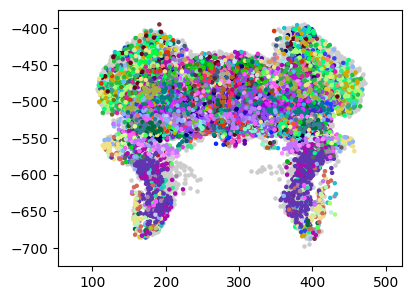

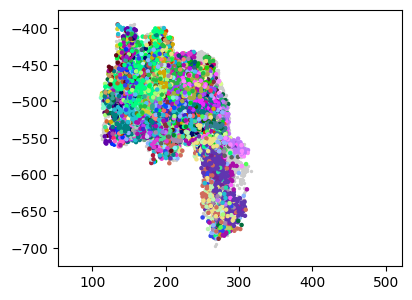

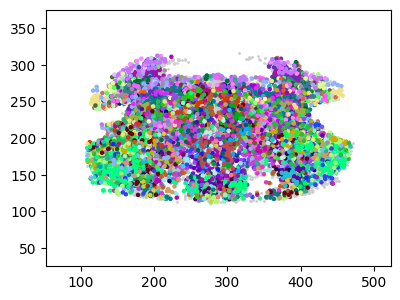

In [50]:

##### to order them by depth on each dimension

###### top view

idx_sort = np.argsort(Coords_All[temp_All,0])

plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,2]*-1,s=5,c='0.8',alpha=1)

plt.scatter(Coords_All[temp_All[idx_sort],1],Coords_All[temp_All[idx_sort],2]*-1,s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-725, -375)  # Set y-axis limits

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_2genes_top_stim_300dpi.png',transparent=True, dpi=300)

###### lateral view

idx_sort = np.argsort(Coords_All[temp_All,1])

plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,0],Coords_All[temp_ff,2]*-1,s=2,c='0.8',alpha=1)

plt.scatter(Coords_All[temp_All[idx_sort],0],Coords_All[temp_All[idx_sort],2]*-1,s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-725, -375)  # Set y-axis limits

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_2genes_side_stim_300dpi.png',transparent=True, dpi=300)

###### front view

idx_sort = np.argsort(Coords_All[temp_All,2])
idx_sort = idx_sort[::-1]

plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,0],s=1,c='0.8',alpha=1)

plt.scatter(Coords_All[temp_All[idx_sort],1],Coords_All[temp_All[idx_sort],0],s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(25, 375)  # Set y-axis limits

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_2genes_front_stim_300dpi.png',transparent=True, dpi=300)


In [51]:
#########################

In [52]:

###### locality index: It's a measure of the KL divergence between the distributions of the coordinates of all neurons vs the coordinates of the neurons in the cluste
###### this verison is to normalize based on the number of bins

##### For P you should input the coordinates (Nx3) of the cluster, for Q the full set of coordinates of all neurons
##### The code creates 3D bins to compare, I set those to 50 (microns) generally, but you can play around a bit with them if you'd like


def KLDiv_discrete2(P, Q, binsize=50):
    # Q is the null distribution; P and Q are 3D distributions

    x_bins = np.append(np.arange(0, np.amax(P[:, 0]), binsize), np.amax(P[:, 0]))
    y_bins = np.append(np.arange(0, np.amax(P[:, 1]), binsize), np.amax(P[:, 1]))
    z_bins = np.append(np.arange(0, np.amax(P[:, 2]), binsize), np.amax(P[:, 2]))

    this_KL = 0
    for i in range(len(x_bins) - 1):
        for j in range(len(y_bins) - 1):
            for k in range(len(z_bins) - 1):
                Qx = (
                    np.sum(
                        (Q[:, 0] >= x_bins[i])
                        & (Q[:, 0] < x_bins[i + 1])
                        & (Q[:, 1] >= y_bins[j])
                        & (Q[:, 1] < y_bins[j + 1])
                        & (Q[:, 2] >= z_bins[k])
                        & (Q[:, 2] < z_bins[k + 1])
                    )
                ) / len(Q)
                Px = (
                    np.sum(
                        (P[:, 0] >= x_bins[i])
                        & (P[:, 0] < x_bins[i + 1])
                        & (P[:, 1] >= y_bins[j])
                        & (P[:, 1] < y_bins[j + 1])
                        & (P[:, 2] >= z_bins[k])
                        & (P[:, 2] < z_bins[k + 1])
                    )
                ) / len(P)
                if (Px == 0) | (
                    Qx == 0
                ):  # no points in test or null distrib -- can't have log(0), or /0
                    continue

                this_KL += Px * np.log(Px / Qx)

    return this_KL/(len(x_bins)*len(y_bins)*len(z_bins))


In [53]:
##### checking the locality index and correlations within subtypes by brain region

minG = 1

thr_corr = 0.1

no_nans = np.where(~np.isnan(Coords_All[:,0]))[0]

good_cells = no_nans

# #### only getting half the brain
# temp_h = np.where(Coords_All[:,1]<285)
# good_cells = np.intersect1d(good_cells,temp_h) 

LocInd_Brain = np.zeros((len(GoodReg)))

LocInd_Brain_Mat = np.zeros((len(good_cls_names),len(GoodReg)))
CorrInd_Brain_Mat = np.zeros((len(good_cls_names),len(GoodReg),3))

corr_sub_perBreg = np.zeros(16)

for bb, b in enumerate(GoodReg[::-1]):

    locInd = np.zeros((len(good_cls_names)))    
    locInd[:] = np.nan

    CorrInd = np.zeros((len(good_cls_names),3))    
    CorrInd[:] = np.nan

    temp_b = np.where(BrainRegions_All[:,b])[0]
    temp_b = np.intersect1d(good_cells,temp_b)         
    
    ####

    counter = 0
    
    for i, cl in enumerate(list(np.unique(cluster_labelsAll3[np.where(cluster_labelsAll3>0)[0]]))):
        if cl in glia_subs:
            continue
        # if g_in_cls[i]<minG:
        #     continue

        temp_cl = np.where(cluster_labelsAll3==cl)[0]
        temp = np.intersect1d(temp_cl,temp_b)
        
        # print(cl)
        
        temp2 = fish_id[temp]
        
        if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:
    
            if len(np.where(temp2==59)[0])/len(temp2)>0.70 or len(np.where(temp2==63)[0])/len(temp2)>0.70 or len(np.where(temp2==71)[0])/len(temp2)>0.70:
                # print(x, good_cls_names[i], BrainRegions_names[b])
                # print(len(np.where(temp2==59)[0])/len(temp2), len(np.where(temp2==63)[0])/len(temp2), len(np.where(temp2==71)[0])/len(temp2))
                continue

    
            locInd[i] = KLDiv_discrete2(Coords_All[temp,:], Coords_All[temp_b], binsize=50)

            #### for correlation across fish (all cells)
            CorrInd[i,0] = np.nanmean(np.corrcoef(dff_traceAllavg[temp,:]))

            #### correlation within each fish 
            CorrInd[i,1] = np.nanmean(np.stack([
            np.nanmean(np.corrcoef(dff_traceAllavg[temp[np.where(temp2==59)[0]],:])[np.where(np.tril(np.corrcoef(dff_traceAllavg[temp[np.where(temp2==59)[0]],:]),-1))]),
            np.nanmean(np.corrcoef(dff_traceAllavg[temp[np.where(temp2==63)[0]],:])[np.where(np.tril(np.corrcoef(dff_traceAllavg[temp[np.where(temp2==63)[0]],:]),-1))]),
            np.nanmean(np.corrcoef(dff_traceAllavg[temp[np.where(temp2==71)[0]],:])[np.where(np.tril(np.corrcoef(dff_traceAllavg[temp[np.where(temp2==71)[0]],:]),-1))])]))
    
            #### for correlation across fish their average activity
            temp_mean = np.zeros((3,134*1))
            temp_mean[0,:] = np.nanmean(dff_traceAllavg[temp[np.where(temp2==59)[0]],:],0)
            temp_mean[1,:] = np.nanmean(dff_traceAllavg[temp[np.where(temp2==63)[0]],:],0)
            temp_mean[2,:] = np.nanmean(dff_traceAllavg[temp[np.where(temp2==71)[0]],:],0)
            
            CorrInd[i,2] = np.nanmean(np.corrcoef(temp_mean)[np.where(np.tril(np.corrcoef(temp_mean),-1))])

            counter = counter + 1
            # print(len(temp))

    corr_sub_perBreg[bb] = counter
    
    LocInd_Brain[bb] = np.nanmean(locInd)

    LocInd_Brain_Mat[:,bb] = locInd

    CorrInd_Brain_Mat[:,bb,:] = CorrInd


(297,)


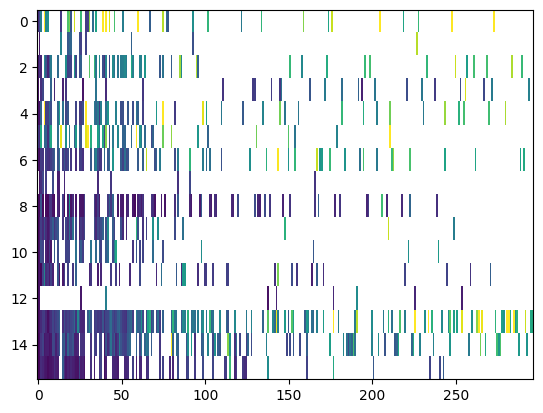

In [54]:

temp = np.where(np.nanmax(LocInd_Brain_Mat,1)>0)[0]
temp = temp.astype(int)
print(temp.shape)
plt.imshow(LocInd_Brain_Mat[temp,:].T,aspect='auto',vmin=0,vmax=0.005,interpolation='nearest')

(297,)


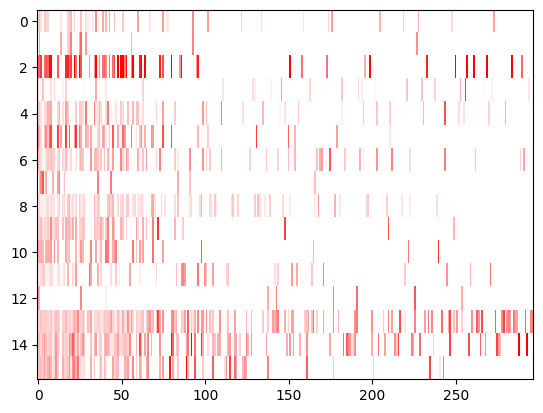

In [55]:

print(temp.shape)
plt.imshow(CorrInd_Brain_Mat[temp,:,1].T,aspect='auto',vmin=-0.5,vmax=0.5,interpolation='nearest',cmap='bwr')

0.3394293455461499
0.0021200792951790856 0.2327957607697064


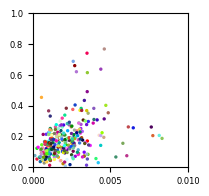

In [56]:
#### correlation between locality index and inner correlation
temp = np.where(np.nanmax(LocInd_Brain_Mat,1)>0)[0]
temp = temp.astype(int)
plt.figure(figsize=(2,2))
plt.scatter(np.nanmean(LocInd_Brain_Mat[temp],1),np.nanmean(CorrInd_Brain_Mat[temp,:,1],1),c=np.array(colors_All)[temp],s=2)

# Set x-ticks and y-ticks with font size 6
plt.xticks(fontsize=6)
plt.yticks(fontsize=6)
plt.ylim(0,1)
plt.xlim(0,0.01)

print(np.corrcoef(np.nanmean(LocInd_Brain_Mat[temp],1),np.nanmean(CorrInd_Brain_Mat[temp,:,1],1))[0][1])


m1 = np.nanmean(np.nanmean(LocInd_Brain_Mat[temp],1)) #+ np.nanstd(np.nanmean(LocInd_Brain_Mat[temp],1))

m2 = np.nanmean(np.nanmean(CorrInd_Brain_Mat[temp],1)) #+ np.nanstd(np.nanmean(CorrInd_Brain_Mat[temp],1))
m2

print(m1,m2)


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/LocInd_vs_InCorr_subtypes.svg',transparent=True, dpi=300)


In [ ]:
#### ploting individual data points using a swarm plot based on:
#### https://python-graph-gallery.com/509-introduction-to-swarm-plot-in-matplotlib/

(0.0, 0.01)

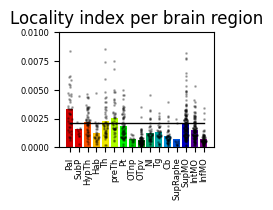

In [58]:
from __future__ import division

def simple_beeswarm2(y, nbins=None, width=1.):
    """
    Returns x coordinates for the points in ``y``, so that plotting ``x`` and
    ``y`` results in a bee swarm plot.
    """
    y = np.asarray(y)
    if nbins is None:
        # nbins = len(y) // 6
        nbins = np.ceil(len(y) / 6).astype(int)

    # Get upper bounds of bins
    x = np.zeros(len(y))

    nn, ybins = np.histogram(y, bins=nbins)
    nmax = nn.max()

    #Divide indices into bins
    ibs = []#np.nonzero((y>=ybins[0])*(y<=ybins[1]))[0]]
    for ymin, ymax in zip(ybins[:-1], ybins[1:]):
        i = np.nonzero((y>ymin)*(y<=ymax))[0]
        ibs.append(i)

    # Assign x indices
    dx = width / (nmax // 2)
    for i in ibs:
        yy = y[i]
        if len(i) > 1:
            j = len(i) % 2
            i = i[np.argsort(yy)]
            a = i[j::2]
            b = i[j+1::2]
            x[a] = (0.5 + j / 3 + np.arange(len(b))) * dx
            x[b] = (0.5 + j / 3 + np.arange(len(b))) * -dx

    return x



# Filter data using np.isnan
mask = ~np.isnan(LocInd_Brain_Mat)
filtered_data = [d[m] for d, m in zip(LocInd_Brain_Mat.T, mask.T)]

fig, ax = plt.subplots(1, 1, figsize=(2, 1.5))
# ax.boxplot(filtered_data, widths=0.5, showfliers=False, showcaps=False)
plt.bar(BrainRegions_names_short[::-1], np.nanmean(LocInd_Brain_Mat,0), color = colors_B[::-1][1:17],alpha=1)


offset = 0

for i in range(LocInd_Brain_Mat.shape[1]):
    x1 = simple_beeswarm2(LocInd_Brain_Mat[:,i][~np.isnan(LocInd_Brain_Mat[:,i])], width=0.25)
    # ax.plot(x1+offset, LocInd_Brain_Mat[:,i][~np.isnan(LocInd_Brain_Mat[:,i])], 'o',c=colors_B[::-1][1:17][i],alpha = 0.1)
    ax.plot(x1+offset, LocInd_Brain_Mat[:,i][~np.isnan(LocInd_Brain_Mat[:,i])], '.',c='k',alpha = 0.25, markersize=2)
    offset = offset + 1

plt.plot(np.arange(16),np.ones(16)*m1, c='k', linewidth=1)

plt.title('Locality index per brain region')
plt.xticks( rotation = 90)
# Set x-ticks and y-ticks with font size 6
plt.xticks(fontsize=6)
plt.yticks(fontsize=6)
plt.ylim([0,0.01])


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/LocInd_PerBrainReg.svg',transparent=True, dpi=300) 

(0.0, 1.0)

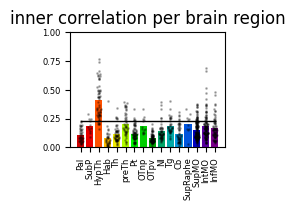

In [59]:
from __future__ import division

def simple_beeswarm2(y, nbins=None, width=1.):
    """
    Returns x coordinates for the points in ``y``, so that plotting ``x`` and
    ``y`` results in a bee swarm plot.
    """
    y = np.asarray(y)
    if nbins is None:
        # nbins = len(y) // 6
        nbins = np.ceil(len(y) / 6).astype(int)

    # Get upper bounds of bins
    x = np.zeros(len(y))

    nn, ybins = np.histogram(y, bins=nbins)
    nmax = nn.max()

    #Divide indices into bins
    ibs = []#np.nonzero((y>=ybins[0])*(y<=ybins[1]))[0]]
    for ymin, ymax in zip(ybins[:-1], ybins[1:]):
        i = np.nonzero((y>ymin)*(y<=ymax))[0]
        ibs.append(i)

    # Assign x indices
    dx = width / (nmax // 2)
    for i in ibs:
        yy = y[i]
        if len(i) > 1:
            j = len(i) % 2
            i = i[np.argsort(yy)]
            a = i[j::2]
            b = i[j+1::2]
            x[a] = (0.5 + j / 3 + np.arange(len(b))) * dx
            x[b] = (0.5 + j / 3 + np.arange(len(b))) * -dx

    return x



# Filter data using np.isnan
mask = ~np.isnan(CorrInd_Brain_Mat)
filtered_data = [d[m] for d, m in zip(CorrInd_Brain_Mat.T, mask.T)]

fig, ax = plt.subplots(1, 1, figsize=(2, 1.5))
# ax.boxplot(filtered_data, widths=0.5, showfliers=False, showcaps=False)
plt.bar(BrainRegions_names_short[::-1], np.nanmean(CorrInd_Brain_Mat[:,:,1],0), color = colors_B[::-1][1:17],alpha=1)


offset = 0

for i in range(LocInd_Brain_Mat.shape[1]):
    x1 = simple_beeswarm2(CorrInd_Brain_Mat[:,i,1][~np.isnan(CorrInd_Brain_Mat[:,i,1])], width=0.25)
    # ax.plot(x1+offset, LocInd_Brain_Mat[:,i,1][~np.isnan(CorrInd_Brain_Mat[:,i,1])], 'o',c=colors_B[::-1][1:17][i],alpha = 0.1)
    ax.plot(x1+offset, CorrInd_Brain_Mat[:,i,1][~np.isnan(CorrInd_Brain_Mat[:,i,1])], '.',c='k',alpha = 0.25, markersize = 2)
    offset = offset + 1


plt.plot(np.arange(16),np.ones(16)*m2, c='k', linewidth=1)

plt.title('inner correlation per brain region')
plt.xticks( rotation = 90)

# Set x-ticks and y-ticks with font size 6
plt.xticks(fontsize=6)
plt.yticks(fontsize=6)
plt.ylim([0,1])


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/InnCorr_PerBrainReg.svg',transparent=True, dpi=300) 

Pal
0
SubP
0
HypTh
24
Hab
1
Th
3
preTh
7
Pt
3
OTnp
0
OTpv
0
NI
5
Tg
4
Cb
1
SupRaphe
1
SupMO
19
IntMO
12
InfMO
2


(array([ 0., 10., 20., 30.]),
 [Text(0, 0.0, '0'),
  Text(0, 10.0, '10'),
  Text(0, 20.0, '20'),
  Text(0, 30.0, '30')])

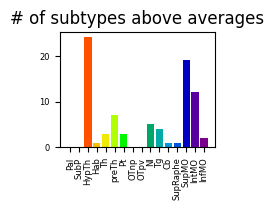

In [60]:
#### checking how many above the mean 

aboveMean = np.zeros((len(BrainRegions_names_short)))

for b in range(LocInd_Brain_Mat.shape[1]):

    test = np.intersect1d(np.where(CorrInd_Brain_Mat[:,b,1]>m2)[0],np.where(LocInd_Brain_Mat[:,b]>m1)[0])
   
    print(BrainRegions_names_short[::-1][b])
    print(len(test))
    aboveMean[b] = len(test)
    
    test = test + 1 #### to make it cl




fig, ax = plt.subplots(1, 1, figsize=(2, 1.5))
# ax.boxplot(filtered_data, widths=0.5, showfliers=False, showcaps=False)
plt.bar(BrainRegions_names_short[::-1], aboveMean, color = colors_B[::-1][1:17],alpha=1)


plt.title('# of subtypes above averages')
plt.xticks( rotation = 90)

# Set x-ticks and y-ticks with font size 6
plt.xticks(fontsize=6)
plt.yticks(fontsize=6)

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/NumSup_aboveAvg_PerBrainReg.svg',transparent=True, dpi=300) 

39
Pal 0.48502581854780175
locinx mean: 0.003282128291528935 corr mean: 0.11153727367799689
11
SubP 0.08414837601612259
locinx mean: 0.0016040903295554264 corr mean: 0.18802409351945784
56
HypTh 0.1849838823398792
locinx mean: 0.002225385654339391 corr mean: 0.4064629168434496
31
Hab 0.7083065982348143
locinx mean: 0.0012784853576318347 corr mean: 0.07878750327261055
54
Th 0.21254117896731042
locinx mean: 0.0022962146939354373 corr mean: 0.11642728408832721
45
preTh -0.13332303959421277
locinx mean: 0.002562588095052247 corr mean: 0.20388475518748703
69
Pt 0.27584060480434025
locinx mean: 0.001880392376967461 corr mean: 0.11952048708050696
13
OTnp 0.11863380890093923
locinx mean: 0.0007183887046340673 corr mean: 0.18851918493761297
78
OTpv 0.22865317861961157
locinx mean: 0.0006759765846008703 corr mean: 0.07967972417620063
48
NI 0.7438144438425295
locinx mean: 0.0012567877614059451 corr mean: 0.1382257167723387
36
Tg 0.6179458162130655
locinx mean: 0.0013061380332834939 corr mean: 0.1

(0.0, 0.01)

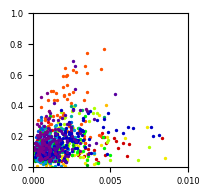

In [61]:
#### correlation between locality index and inner correlation
#### looking at particular brain regions
plt.figure(figsize=(2,2))
for b in range(LocInd_Brain_Mat.shape[1]):
# for b in [13]:

    temp = np.where(LocInd_Brain_Mat[:,b]>0)[0]
    temp = temp.astype(int)
    print(len(temp))
    plt.scatter(LocInd_Brain_Mat[temp,b],CorrInd_Brain_Mat[temp,b,1], c=colors_B[::-1][b+1],s=2)
    print(BrainRegions_names_short[::-1][b]+' '+ str(np.corrcoef(LocInd_Brain_Mat[temp,b],CorrInd_Brain_Mat[temp,b,1])[0][1]))
    print('locinx mean: '+str(np.nanmean(LocInd_Brain_Mat[temp,b]))+' corr mean: '+ str(np.nanmean(CorrInd_Brain_Mat[temp,b,1])))


# Set x-ticks and y-ticks with font size 6
plt.xticks(fontsize=6)
plt.yticks(fontsize=6)
plt.ylim(0,1)
plt.xlim(0,0.01)


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/LocInd_vs_InCorr_BrainReg.svg',transparent=True, dpi=300)


146
SupMO 0.5991506859169374
locinx mean: 0.0021065191468509193 corr mean: 0.15224443089837367


(0.0, 0.01)

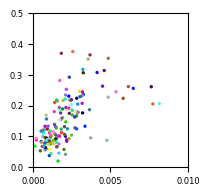

In [62]:
#### correlation between locality index and inner correlation
#### looking at particular brain regions
plt.figure(figsize=(2,2))
# for b in range(LocInd_Brain_Mat.shape[1]):
for b in [13]:

    temp = np.where(LocInd_Brain_Mat[:,b]>0)[0]
    temp = temp.astype(int)
    print(len(temp))
    plt.scatter(LocInd_Brain_Mat[temp,b],CorrInd_Brain_Mat[temp,b,1], c=np.array(colors_All)[temp],s =2)
    print(BrainRegions_names_short[::-1][b]+' '+ str(np.corrcoef(LocInd_Brain_Mat[temp,b],CorrInd_Brain_Mat[temp,b,1])[0][1]))
    print('locinx mean: '+str(np.nanmean(LocInd_Brain_Mat[temp,b]))+' corr mean: '+ str(np.nanmean(CorrInd_Brain_Mat[temp,b,1])))


# Set x-ticks and y-ticks with font size 6
plt.xticks(fontsize=6)
plt.yticks(fontsize=6)
plt.ylim(0,0.5)
plt.xlim(0,0.01)


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/LocInd_vs_InCorr_SupMo.svg',transparent=True, dpi=300)


In [63]:
#### how many in the SupMO would be above the mean + std

for b in [13]:

    test = np.intersect1d(np.where(CorrInd_Brain_Mat[:,b,1]>m2)[0],np.where(LocInd_Brain_Mat[:,b]>m1)[0])
  
    print(BrainRegions_names_short[::-1][b])
    print(len(test))
    
    print(np.array(good_cls_names)[test])
    
    test = test + 1 #### to make it cl
    print(test)

SupMO
19
['chata_nefma' 'tac1_chata_nefma' 'vglut2a_calb2a_zic2a' 'gad1b_sst_otpa'
 'eomesa_vglut2a_zic2a_esrrb' 'vglut2a_uts1_nr4a2a' 'gad1b_tph2'
 'tac1_uts1_chata_nefma' 'sst_otpa' 'calb2a_pyya' 'tac1_chata_nefma_esrrb'
 'penkb_otpa' 'vglut2a_uts1_zic2a' 'vglut2a_uts1_crhb' 'irx1b_calb2a_pyya'
 'tac1_uts1_chata' 'gad1b_sst_cort_otpa' 'vglut2a_uts1_zic2a_esrrb'
 'penka_gad1b_otpa']
[ 85  95 153 205 224 231 243 253 255 262 268 288 295 304 309 312 317 327
 331]


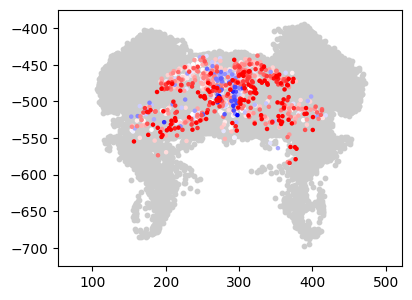

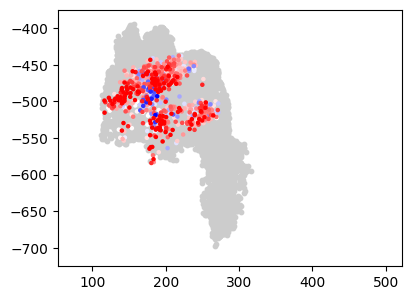

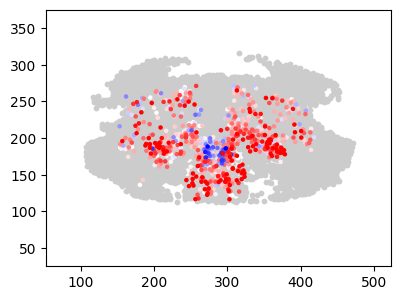

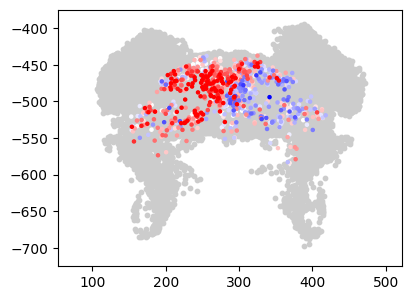

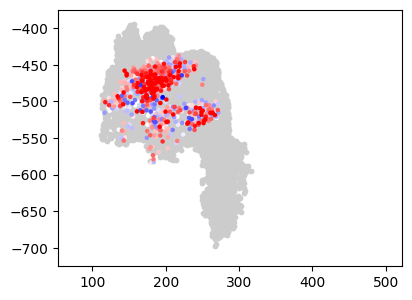

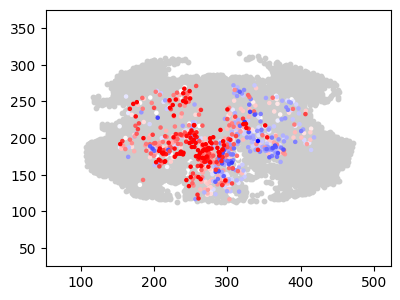

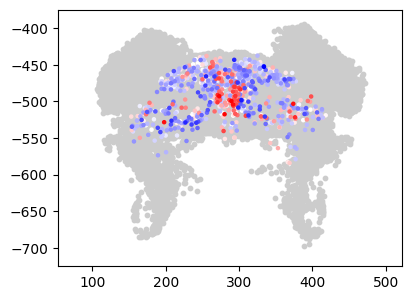

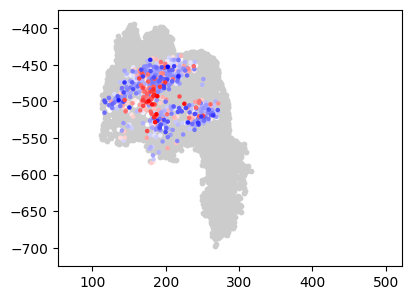

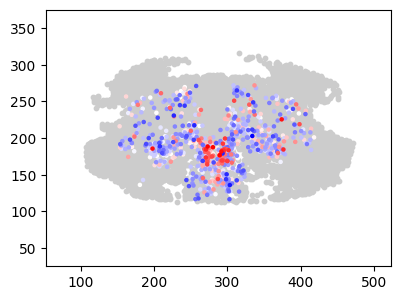

In [64]:
#### now looking at subtypes and traces in the thalamus or another particular brain region
#### to plot their correlation to stimuli or max response

minG = 2 #### minimum number of genes in a subtype

f = 59

temp_f = np.where(fish_id==f)[0]

bb = BrainRegions_names.tolist().index('superior_medulla_oblongata')
# b = BrainRegions_names.tolist().index('superior_raphe')
# bb = BrainRegions_names.tolist().index('prethalamus_(ventral_thalamus)')
# bb = BrainRegions_names.tolist().index('dorsal_thalamus_proper')
# b = BrainRegions_names.tolist().index('periventricular_layer')
# bb = BrainRegions_names.tolist().index('dorsal_telencephalon_(pallium)')
# b = BrainRegions_names.tolist().index('telencephalon')

#### selecting just a brain region
temp_ff = np.intersect1d(temp_f, np.where(BrainRegions_All[:,bb])[0])


sub_perSim_innerCorr = []


# for s in range(9):
for s in [0,2,4]:

    if s in [0,]:
        minc = -0.3
        maxc = 0.3
    if s in [1,2,3,4,5,6,7]:
        minc = -0.2
        maxc = 0.2
    if s in [9]:
        minc = -1
        maxc = 1

    plt.figure(figsize=(4/0.9,3/0.9))
    plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,2]*-1,s=10,c='0.8',alpha=1)
    
    names = ['all cells']
    
    temp_All = np.zeros((1))
    
    # for b in (GoodReg):
    for b in ([bb]):
    
        temp_f = np.where(fish_id==f)[0]
        
        
        
        for i, cl in enumerate(list(np.unique(cluster_labelsAll3)[1::][np.where(g_in_cls>=minG)[0]])):
        

            # # #### selecting some specific ones
            if cl not in test:
                continue
            
            if cl in glia_subs:
                continue
            temp = np.where(cluster_labelsAll3==cl)[0]
            # print(cl)


            
            ##### if looking at a particular brain region
            temp_b = np.where(BrainRegions_All[:,b])[0]  #### 9 = thalamus
            temp = np.intersect1d(temp,temp_b)
            
            temp2 = fish_id[temp]
        
        
            if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:
        
                if len(np.where(temp2==59)[0])/len(temp2)>0.70 or len(np.where(temp2==63)[0])/len(temp2)>0.70 or len(np.where(temp2==71)[0])/len(temp2)>0.70:
                  
                    continue
        
    
                temp_All = np.hstack((temp_All, temp))
                
                names.append(good_cls_names[np.where(g_in_cls>=minG)[0][i]])
        
    
    temp_All = temp_All[1::].astype(int)


    sub_perSim_innerCorr.append(np.unique(cluster_labelsAll3[temp_All]))
    
    
    if s<8:
        sort_idx = np.argsort(np.absolute(big_corr_regsAllMix[temp_All,s]))
        # sort_idx = np.argsort(np.absolute(high_corr_perSimMix[temp_All,s]))
    
        plt.scatter(Coords_All[temp_All[sort_idx],1],Coords_All[temp_All[sort_idx],2]*-1,s=5,alpha=1,c=big_corr_regsAllMix[temp_All[sort_idx],s],cmap='bwr',vmin=minc, vmax=maxc)
        # plt.colorbar()
    
    elif s==8:
        sort_idx2 = np.argsort(np.absolute(swim_corr_All[temp_All]))
        plt.scatter(Coords_All[temp_All[sort_idx2],1],Coords_All[temp_All[sort_idx2],2]*-1,s=5,alpha=1,c=swim_corr_All[temp_All[sort_idx2]],cmap='bwr',vmin=minc, vmax=maxc)


    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(-725, -375)  # Set y-axis limits
    
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_corr_test_top_stim_{}_300dpi.png'.format(s+1),transparent=True, dpi=300)
    
    ####### lateral view
    
    
    plt.figure(figsize=(4/0.9,3/0.9))
    plt.scatter(Coords_All[temp_ff,0],Coords_All[temp_ff,2]*-1,s=10,c='0.8',alpha=1)
    
    
    names = ['all cells']
   
        
    if s<8:
        plt.scatter(Coords_All[temp_All[sort_idx],0],Coords_All[temp_All[sort_idx],2]*-1,s=5,alpha=1,c=big_corr_regsAllMix[temp_All[sort_idx],s],cmap='bwr',vmin=minc, vmax=maxc)
    
    elif s==8:
        plt.scatter(Coords_All[temp_All[sort_idx2],0],Coords_All[temp_All[sort_idx2],2]*-1,s=5,alpha=1,c=swim_corr_All[temp_All[sort_idx2]],cmap='bwr',vmin=minc, vmax=maxc)
    

    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(-725, -375)  # Set y-axis limits
    
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_corr_test_side_stim_{}_300dpi.png'.format(s+1),transparent=True, dpi=300)
    
    ####### coronal view
    
    plt.figure(figsize=(4/0.9,3/0.9))
    plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,0],s=10,c='0.8',alpha=1)
    

    if s<8:
    
        plt.scatter(Coords_All[temp_All[sort_idx],1],Coords_All[temp_All[sort_idx],0],s=5,alpha=1,c=big_corr_regsAllMix[temp_All[sort_idx],s],cmap='bwr',vmin=minc, vmax=maxc)

    elif s==8:
        plt.scatter(Coords_All[temp_All[sort_idx2],1],Coords_All[temp_All[sort_idx2],0],s=5,alpha=1,c=swim_corr_All[temp_All[sort_idx2]],cmap='bwr',vmin=minc, vmax=maxc)

    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(25, 375)  # Set y-axis limits
        
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_corr_test_front_stim_{}_300dpi.png'.format(s+1),transparent=True, dpi=300)
        

(25.0, 375.0)

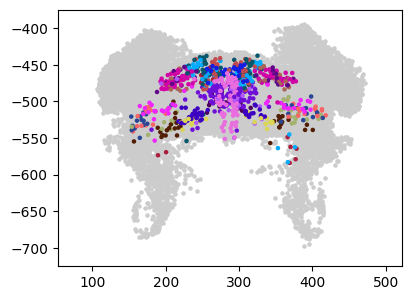

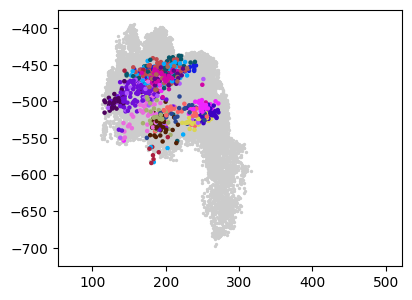

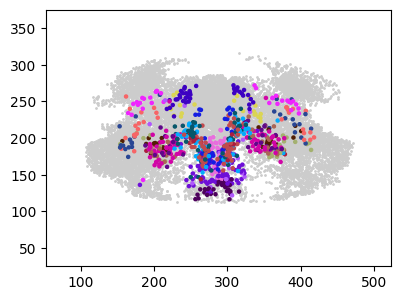

In [65]:

##### to order them by depth on each dimension

###### top view

idx_sort = np.argsort(Coords_All[temp_All,0])

plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,2]*-1,s=5,c='0.8',alpha=1)

plt.scatter(Coords_All[temp_All[idx_sort],1],Coords_All[temp_All[idx_sort],2]*-1,s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-725, -375)  # Set y-axis limits

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_2genes_top_stim_300dpi.png',transparent=True, dpi=300)

###### lateral view

idx_sort = np.argsort(Coords_All[temp_All,1])

plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,0],Coords_All[temp_ff,2]*-1,s=2,c='0.8',alpha=1)

plt.scatter(Coords_All[temp_All[idx_sort],0],Coords_All[temp_All[idx_sort],2]*-1,s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-725, -375)  # Set y-axis limits

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_2genes_side_stim_300dpi.png',transparent=True, dpi=300)

###### front view

idx_sort = np.argsort(Coords_All[temp_All,2])
idx_sort = idx_sort[::-1]

plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,0],s=1,c='0.8',alpha=1)

plt.scatter(Coords_All[temp_All[idx_sort],1],Coords_All[temp_All[idx_sort],0],s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(25, 375)  # Set y-axis limits

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_2genes_front_stim_300dpi.png',transparent=True, dpi=300)


(88.44203683640302, 489.6449466026931, 101.8578947368421, 326.72105263157897)

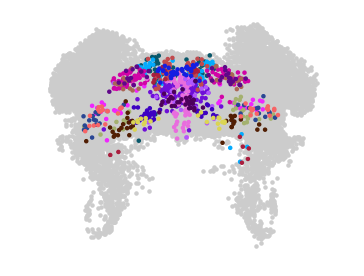

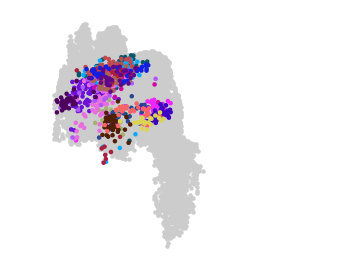

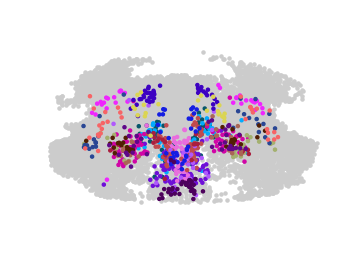

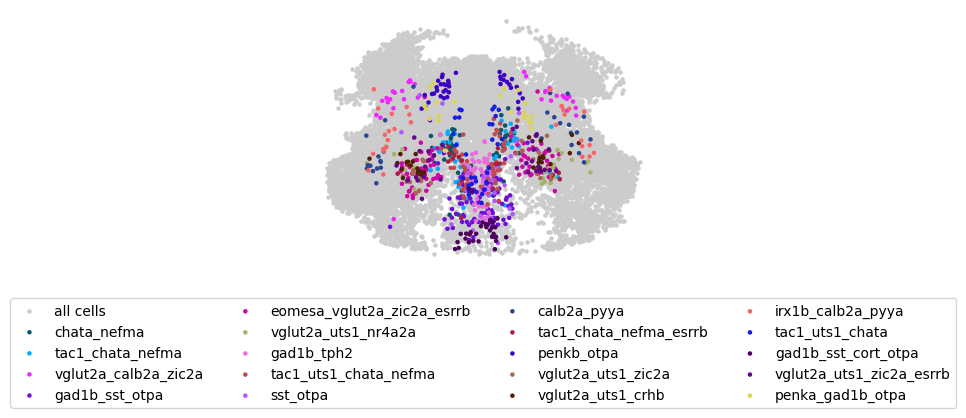

In [66]:

import scipy.stats as st

plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,2]*-1,s=5,c='0.8',alpha=1)

for cl in np.unique(cluster_labelsAll3[temp_All]):

    #### selecting some
    if cl not in test:
        continue
   

    ###### top view
    
    idx_sort = np.where(cluster_labelsAll3[temp_All]==cl)[0]

    sort_idx = np.argsort(np.absolute(big_corr_regsAllMix[temp_All[idx_sort],s]))

    plt.scatter(Coords_All[temp_All[idx_sort],1],Coords_All[temp_All[idx_sort],2]*-1,s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332) 

    x = Coords_All[temp_All[idx_sort],1]
    y = Coords_All[temp_All[idx_sort],2]
    y = y*-1
    
    xmin, xmax = np.min(x)-10, np.max(x)+10
    ymin, ymax = np.min(y)-10, np.max(y)+10
    
    
    # Peform the kernel density estimate
    xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
    
    positions = np.vstack([xx.ravel(), yy.ravel()])
    values = np.vstack([x, y])
    kernel = st.gaussian_kde(values, bw_method=0.15)
    f = np.reshape(kernel(positions).T, xx.shape)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-725, -375)  # Set y-axis limits
plt.axis('off')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_selected_morph2_top_300dpi.png',transparent=True, dpi=300)
    
###### lateral view
plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,0],Coords_All[temp_ff,2]*-1,s=5,c='0.8',alpha=1)

for cl in np.unique(cluster_labelsAll3[temp_All]):

    #### selecting some
    if cl not in test:
        continue

    idx_sort = np.where(cluster_labelsAll3[temp_All]==cl)[0]
    
    sort_idx = np.argsort(np.absolute(big_corr_regsAllMix[temp_All[idx_sort],s]))
    
    plt.scatter(Coords_All[temp_All[idx_sort],0],Coords_All[temp_All[idx_sort],2]*-1,s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)

    x = Coords_All[temp_All[idx_sort],0]
    y = Coords_All[temp_All[idx_sort],2]
    y = y*-1
    
    xmin, xmax = np.min(x)-10, np.max(x)+10
    ymin, ymax = np.min(y)-10, np.max(y)+10
    
    
    # Peform the kernel density estimate
    xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
    
    positions = np.vstack([xx.ravel(), yy.ravel()])
    values = np.vstack([x, y])
    kernel = st.gaussian_kde(values, bw_method=0.15)
    f = np.reshape(kernel(positions).T, xx.shape)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-725, -375)  # Set y-axis limits
plt.axis('off')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_selected_morph2_side_300dpi.png',transparent=True, dpi=300)
    
###### front view
    
plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,0],s=5,c='0.8',alpha=1)
temp_legend = ['all cells']
for cl in np.unique(cluster_labelsAll3[temp_All]):

    #### selecting some
    if cl not in test:
        continue

    idx_sort = np.where(cluster_labelsAll3[temp_All]==cl)[0]

    sort_idx = np.argsort(np.absolute(big_corr_regsAllMix[temp_All[idx_sort],s]))
    # sort_idx = np.argsort(np.absolute(high_corr_perSimMix[temp_All[idx_sort],s]))
    
    plt.scatter(Coords_All[temp_All[idx_sort],1],Coords_All[temp_All[idx_sort],0],s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)
    # plt.scatter(Coords_All[temp_All[idx_sort[sort_idx]],1],Coords_All[temp_All[idx_sort[sort_idx]],0],s=5,alpha=1,c=big_corr_regsAllMix[temp_All[idx_sort[sort_idx]],s],cmap='bwr',vmin=-0.5, vmax=0.5)
    

    x = Coords_All[temp_All[idx_sort],1]
    y = Coords_All[temp_All[idx_sort],0]
    
    xmin, xmax = np.min(x)-10, np.max(x)+10
    ymin, ymax = np.min(y)-10, np.max(y)+10
    
    
    # Peform the kernel density estimate
    xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
    
    positions = np.vstack([xx.ravel(), yy.ravel()])
    values = np.vstack([x, y])
    kernel = st.gaussian_kde(values, bw_method=0.15)
    f = np.reshape(kernel(positions).T, xx.shape)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(25, 375)  # Set y-axis limits
plt.axis('off')


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_selected_morph2_front_300dpi.png',transparent=True, dpi=300)
   
###### front view (with legend)
    
plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,0],s=5,c='0.8',alpha=1)
temp_legend = ['all cells']
for cl in np.unique(cluster_labelsAll3[temp_All]):

    #### selecting some
    if cl not in test:
        continue

    idx_sort = np.where(cluster_labelsAll3[temp_All]==cl)[0]

    sort_idx = np.argsort(np.absolute(big_corr_regsAllMix[temp_All[idx_sort],s]))
   
    plt.scatter(Coords_All[temp_All[idx_sort],1],Coords_All[temp_All[idx_sort],0],s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)

    x = Coords_All[temp_All[idx_sort],1]
    y = Coords_All[temp_All[idx_sort],0]
    
    xmin, xmax = np.min(x)-10, np.max(x)+10
    ymin, ymax = np.min(y)-10, np.max(y)+10
    
    
    # Peform the kernel density estimate
    xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
    
    positions = np.vstack([xx.ravel(), yy.ravel()])
    values = np.vstack([x, y])
    kernel = st.gaussian_kde(values, bw_method=0.15)
    f = np.reshape(kernel(positions).T, xx.shape)
    
    temp_legend.append(str(np.array(good_cls_names)[np.unique(cluster_labelsAll3[temp_All[idx_sort]])-1][0]))
    
plt.legend(temp_legend, loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=4)

plt.axis('off')


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_selected_morph2_front_legend_300dpi.svg',transparent=True, dpi=300)

In [1]:
##############


In [68]:
#### 6 examples with high loc index and inner correlation
SubToTest2 = [205, 224, 243, 253, 309, 331]

##### manually selected for morphology 1
# SubToTest2 = [13, 24, 27, 46, 56, 75]

##### manually selected for morphology 2
# SubToTest2 = [68, 172, 205, 224, 243, 253]

In [69]:
###################

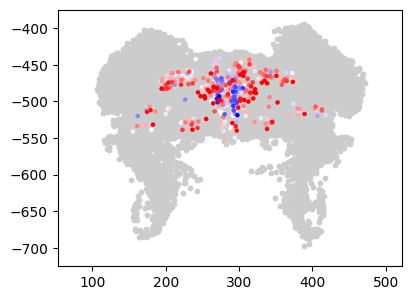

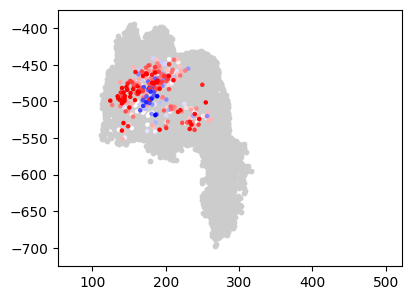

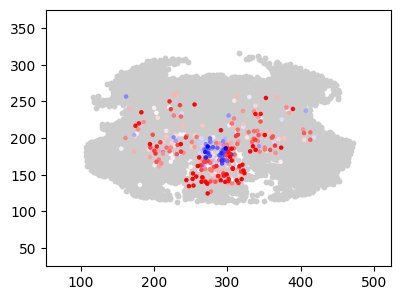

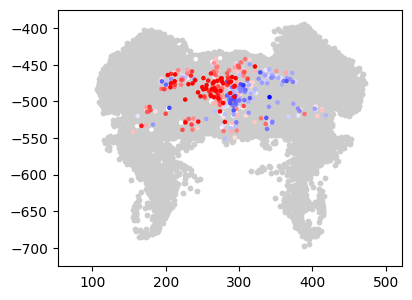

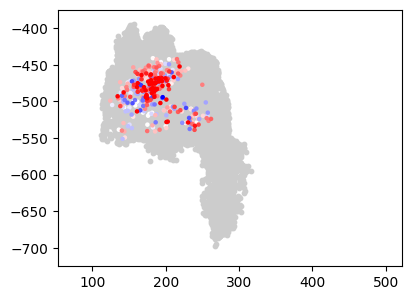

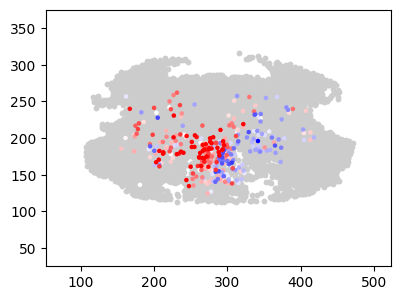

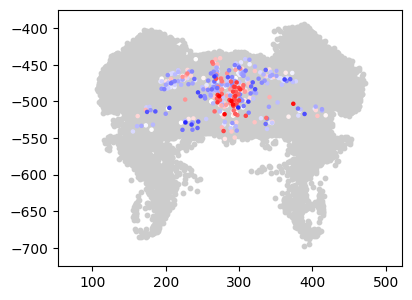

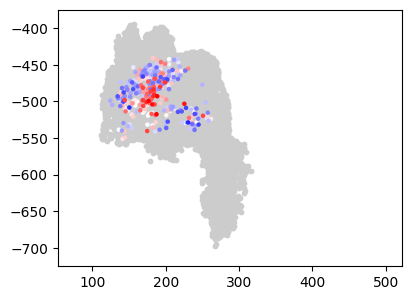

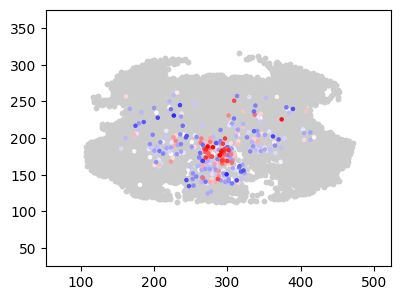

In [70]:
#### now looking at subtypes and traces in the thalamus or another particular brain region
#### to plot their correlation to stimuli or max response


minG = 2 #### minimum number of genes in a subtype

f = 59

temp_f = np.where(fish_id==f)[0]

bb = BrainRegions_names.tolist().index('superior_medulla_oblongata')
# b = BrainRegions_names.tolist().index('superior_raphe')
# bb = BrainRegions_names.tolist().index('prethalamus_(ventral_thalamus)')
# bb = BrainRegions_names.tolist().index('dorsal_thalamus_proper')
# b = BrainRegions_names.tolist().index('periventricular_layer')
# bb = BrainRegions_names.tolist().index('dorsal_telencephalon_(pallium)')
# b = BrainRegions_names.tolist().index('telencephalon')

#### selecting just a brain region
temp_ff = np.intersect1d(temp_f, np.where(BrainRegions_All[:,bb])[0])


sub_perSim_innerCorr = []


# for s in range(9):
for s in [0,2,4]:

    if s in [0,]:
        minc = -0.3
        maxc = 0.3
    if s in [1,2,3,4,5,6,7]:
        minc = -0.2
        maxc = 0.2
    if s in [9]:
        minc = -1
        maxc = 1

    plt.figure(figsize=(4/0.9,3/0.9))
    plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,2]*-1,s=10,c='0.8',alpha=1)
    
    names = ['all cells']
    
    temp_All = np.zeros((1))
    
    # for b in (GoodReg):
    for b in ([bb]):
    
        temp_f = np.where(fish_id==f)[0]
        
        
        
        for i, cl in enumerate(list(np.unique(cluster_labelsAll3)[1::][np.where(g_in_cls>=minG)[0]])):
        

            # # #### selecting some specific ones
            if cl not in SubToTest2:
                continue
            
            if cl in glia_subs:
                continue
            temp = np.where(cluster_labelsAll3==cl)[0]
            # print(cl)


            
            ##### if looking at a particular brain region
            temp_b = np.where(BrainRegions_All[:,b])[0]  #### 9 = thalamus
            temp = np.intersect1d(temp,temp_b)
            
            temp2 = fish_id[temp]
        
        
            if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:
        
                if len(np.where(temp2==59)[0])/len(temp2)>0.70 or len(np.where(temp2==63)[0])/len(temp2)>0.70 or len(np.where(temp2==71)[0])/len(temp2)>0.70:
                  
                    continue
        
    
                temp_All = np.hstack((temp_All, temp))
                
                names.append(good_cls_names[np.where(g_in_cls>=minG)[0][i]])
        
    
    temp_All = temp_All[1::].astype(int)


    sub_perSim_innerCorr.append(np.unique(cluster_labelsAll3[temp_All]))
    
    
    if s<8:
        sort_idx = np.argsort(np.absolute(big_corr_regsAllMix[temp_All,s]))
        # sort_idx = np.argsort(np.absolute(high_corr_perSimMix[temp_All,s]))
    
        plt.scatter(Coords_All[temp_All[sort_idx],1],Coords_All[temp_All[sort_idx],2]*-1,s=5,alpha=1,c=big_corr_regsAllMix[temp_All[sort_idx],s],cmap='bwr',vmin=minc, vmax=maxc)
        # plt.colorbar()
    
    elif s==8:
        sort_idx2 = np.argsort(np.absolute(swim_corr_All[temp_All]))
        plt.scatter(Coords_All[temp_All[sort_idx2],1],Coords_All[temp_All[sort_idx2],2]*-1,s=5,alpha=1,c=swim_corr_All[temp_All[sort_idx2]],cmap='bwr',vmin=minc, vmax=maxc)


    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(-725, -375)  # Set y-axis limits
    
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_corr_test_top_stim_{}_300dpi.png'.format(s+1),transparent=True, dpi=300)
    
    ####### lateral view
    
    
    plt.figure(figsize=(4/0.9,3/0.9))
    plt.scatter(Coords_All[temp_ff,0],Coords_All[temp_ff,2]*-1,s=10,c='0.8',alpha=1)
    
    
    names = ['all cells']
   
        
    if s<8:
        plt.scatter(Coords_All[temp_All[sort_idx],0],Coords_All[temp_All[sort_idx],2]*-1,s=5,alpha=1,c=big_corr_regsAllMix[temp_All[sort_idx],s],cmap='bwr',vmin=minc, vmax=maxc)
    
    elif s==8:
        plt.scatter(Coords_All[temp_All[sort_idx2],0],Coords_All[temp_All[sort_idx2],2]*-1,s=5,alpha=1,c=swim_corr_All[temp_All[sort_idx2]],cmap='bwr',vmin=minc, vmax=maxc)
    

    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(-725, -375)  # Set y-axis limits
    
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_corr_test_side_stim_{}_300dpi.png'.format(s+1),transparent=True, dpi=300)
    
    ####### coronal view
    
    plt.figure(figsize=(4/0.9,3/0.9))
    plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,0],s=10,c='0.8',alpha=1)
    

    if s<8:
    
        plt.scatter(Coords_All[temp_All[sort_idx],1],Coords_All[temp_All[sort_idx],0],s=5,alpha=1,c=big_corr_regsAllMix[temp_All[sort_idx],s],cmap='bwr',vmin=minc, vmax=maxc)

    elif s==8:
        plt.scatter(Coords_All[temp_All[sort_idx2],1],Coords_All[temp_All[sort_idx2],0],s=5,alpha=1,c=swim_corr_All[temp_All[sort_idx2]],cmap='bwr',vmin=minc, vmax=maxc)

    plt.axis('equal')
    plt.xlim(25, 550)  # Set x-axis limits
    plt.ylim(25, 375)  # Set y-axis limits
        
    # plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_corr_test_front_stim_{}_300dpi.png'.format(s+1),transparent=True, dpi=300)
        

(25.0, 375.0)

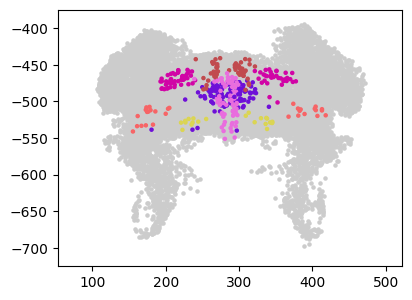

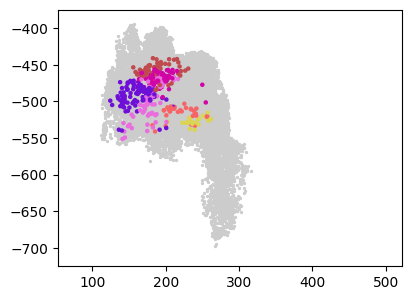

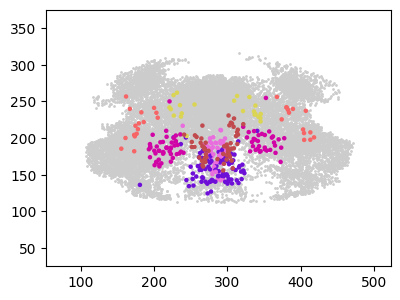

In [71]:

##### to order them by depth on each dimension

###### top view

idx_sort = np.argsort(Coords_All[temp_All,0])

plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,2]*-1,s=5,c='0.8',alpha=1)

plt.scatter(Coords_All[temp_All[idx_sort],1],Coords_All[temp_All[idx_sort],2]*-1,s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-725, -375)  # Set y-axis limits

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_2genes_top_stim_300dpi.png',transparent=True, dpi=300)

###### lateral view

idx_sort = np.argsort(Coords_All[temp_All,1])

plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,0],Coords_All[temp_ff,2]*-1,s=2,c='0.8',alpha=1)

plt.scatter(Coords_All[temp_All[idx_sort],0],Coords_All[temp_All[idx_sort],2]*-1,s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-725, -375)  # Set y-axis limits

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_2genes_side_stim_300dpi.png',transparent=True, dpi=300)

###### front view

idx_sort = np.argsort(Coords_All[temp_All,2])
idx_sort = idx_sort[::-1]

plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,0],s=1,c='0.8',alpha=1)

plt.scatter(Coords_All[temp_All[idx_sort],1],Coords_All[temp_All[idx_sort],0],s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(25, 375)  # Set y-axis limits

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_2genes_front_stim_300dpi.png',transparent=True, dpi=300)


(88.44203683640302, 489.6449466026931, 101.8578947368421, 326.72105263157897)

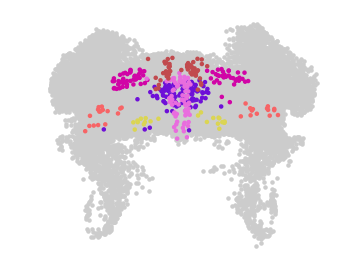

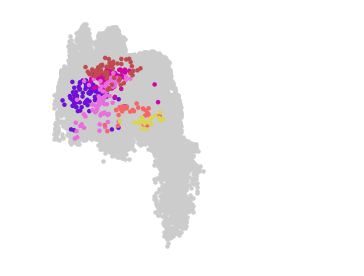

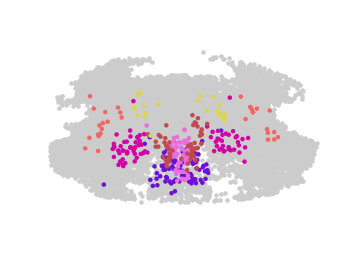

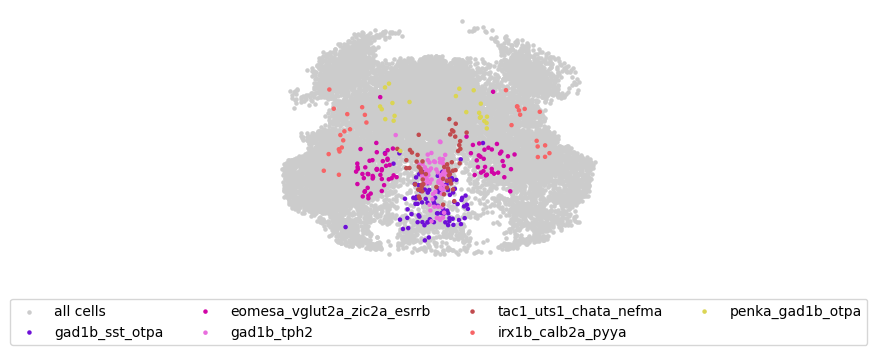

In [72]:

import scipy.stats as st

plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,2]*-1,s=5,c='0.8',alpha=1)

for cl in np.unique(cluster_labelsAll3[temp_All]):

    #### selecting some
    if cl not in SubToTest2:
        continue
   

    ###### top view
    
    idx_sort = np.where(cluster_labelsAll3[temp_All]==cl)[0]

    sort_idx = np.argsort(np.absolute(big_corr_regsAllMix[temp_All[idx_sort],s]))

    plt.scatter(Coords_All[temp_All[idx_sort],1],Coords_All[temp_All[idx_sort],2]*-1,s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332) 

    x = Coords_All[temp_All[idx_sort],1]
    y = Coords_All[temp_All[idx_sort],2]
    y = y*-1
    
    xmin, xmax = np.min(x)-10, np.max(x)+10
    ymin, ymax = np.min(y)-10, np.max(y)+10
    
    
    # Peform the kernel density estimate
    xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
    
    positions = np.vstack([xx.ravel(), yy.ravel()])
    values = np.vstack([x, y])
    kernel = st.gaussian_kde(values, bw_method=0.15)
    f = np.reshape(kernel(positions).T, xx.shape)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-725, -375)  # Set y-axis limits
plt.axis('off')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_selected_morph2_top_300dpi.png',transparent=True, dpi=300)
    
###### lateral view
plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,0],Coords_All[temp_ff,2]*-1,s=5,c='0.8',alpha=1)

for cl in np.unique(cluster_labelsAll3[temp_All]):

    #### selecting some
    if cl not in SubToTest2:
        continue

    idx_sort = np.where(cluster_labelsAll3[temp_All]==cl)[0]
    
    sort_idx = np.argsort(np.absolute(big_corr_regsAllMix[temp_All[idx_sort],s]))
    
    plt.scatter(Coords_All[temp_All[idx_sort],0],Coords_All[temp_All[idx_sort],2]*-1,s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)

    x = Coords_All[temp_All[idx_sort],0]
    y = Coords_All[temp_All[idx_sort],2]
    y = y*-1
    
    xmin, xmax = np.min(x)-10, np.max(x)+10
    ymin, ymax = np.min(y)-10, np.max(y)+10
    
    
    # Peform the kernel density estimate
    xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
    
    positions = np.vstack([xx.ravel(), yy.ravel()])
    values = np.vstack([x, y])
    kernel = st.gaussian_kde(values, bw_method=0.15)
    f = np.reshape(kernel(positions).T, xx.shape)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-725, -375)  # Set y-axis limits
plt.axis('off')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_selected_morph2_side_300dpi.png',transparent=True, dpi=300)
    
###### front view
    
plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,0],s=5,c='0.8',alpha=1)
temp_legend = ['all cells']
for cl in np.unique(cluster_labelsAll3[temp_All]):

    #### selecting some
    if cl not in SubToTest2:
        continue

    idx_sort = np.where(cluster_labelsAll3[temp_All]==cl)[0]

    sort_idx = np.argsort(np.absolute(big_corr_regsAllMix[temp_All[idx_sort],s]))
    # sort_idx = np.argsort(np.absolute(high_corr_perSimMix[temp_All[idx_sort],s]))
    
    plt.scatter(Coords_All[temp_All[idx_sort],1],Coords_All[temp_All[idx_sort],0],s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)
    # plt.scatter(Coords_All[temp_All[idx_sort[sort_idx]],1],Coords_All[temp_All[idx_sort[sort_idx]],0],s=5,alpha=1,c=big_corr_regsAllMix[temp_All[idx_sort[sort_idx]],s],cmap='bwr',vmin=-0.5, vmax=0.5)
    

    x = Coords_All[temp_All[idx_sort],1]
    y = Coords_All[temp_All[idx_sort],0]
    
    xmin, xmax = np.min(x)-10, np.max(x)+10
    ymin, ymax = np.min(y)-10, np.max(y)+10
    
    
    # Peform the kernel density estimate
    xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
    
    positions = np.vstack([xx.ravel(), yy.ravel()])
    values = np.vstack([x, y])
    kernel = st.gaussian_kde(values, bw_method=0.15)
    f = np.reshape(kernel(positions).T, xx.shape)

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(25, 375)  # Set y-axis limits
plt.axis('off')


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_selected_morph2_front_300dpi.png',transparent=True, dpi=300)
   
###### front view (with legend)
    
plt.figure(figsize=(4/0.9,3/0.9))
plt.scatter(Coords_All[temp_ff,1],Coords_All[temp_ff,0],s=5,c='0.8',alpha=1)
temp_legend = ['all cells']
for cl in np.unique(cluster_labelsAll3[temp_All]):

    #### selecting some
    if cl not in SubToTest2:
        continue

    idx_sort = np.where(cluster_labelsAll3[temp_All]==cl)[0]

    sort_idx = np.argsort(np.absolute(big_corr_regsAllMix[temp_All[idx_sort],s]))
   
    plt.scatter(Coords_All[temp_All[idx_sort],1],Coords_All[temp_All[idx_sort],0],s=5,cmap=cmap_All,c=cluster_labelsAll3[temp_All[idx_sort]],alpha=1,vmin=1,vmax=332)

    x = Coords_All[temp_All[idx_sort],1]
    y = Coords_All[temp_All[idx_sort],0]
    
    xmin, xmax = np.min(x)-10, np.max(x)+10
    ymin, ymax = np.min(y)-10, np.max(y)+10
    
    
    # Peform the kernel density estimate
    xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
    
    positions = np.vstack([xx.ravel(), yy.ravel()])
    values = np.vstack([x, y])
    kernel = st.gaussian_kde(values, bw_method=0.15)
    f = np.reshape(kernel(positions).T, xx.shape)
    
    temp_legend.append(str(np.array(good_cls_names)[np.unique(cluster_labelsAll3[temp_All[idx_sort]])-1][0]))
    
plt.legend(temp_legend, loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=4)

plt.axis('off')


# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SupMO_subtyp_selected_morph2_front_legend_300dpi.svg',transparent=True, dpi=300)

In [73]:
##################

In [35]:
### making a heatmap of subtypes

Avg_subty_PerBreg = np.zeros((len(GoodReg)))

Avg_subty_PerBreg_ratio = np.zeros((len(GoodReg)))

names = ['NumSubtypes']

count = 0

for i, cl in enumerate(np.unique(cluster_labelsAll3[np.where(cluster_labelsAll3>0)[0]])):

    temp_cl = np.where(cluster_labelsAll3==cl)[0]
    
        
    names.append(good_cls_names[i])
    
    count = count + 1
    
    cell_count = np.zeros((len(GoodReg)))
    cell_ratio = np.zeros((len(GoodReg)))
    for j,b in enumerate(GoodReg):
        temp_b = np.where(BrainRegions_All[:,b])[0]
        temp = np.intersect1d(temp_cl,temp_b)

        temp2 = fish_id[temp]

        if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:
                
            if len(np.where(temp2==59)[0])/len(temp2)>0.70 or len(np.where(temp2==63)[0])/len(temp2)>0.70 or len(np.where(temp2==71)[0])/len(temp2)>0.70:
                # print(x, good_cls_names[i], BrainRegions_names[b])
                # print(len(np.where(temp2==59)[0])/len(temp2), len(np.where(temp2==63)[0])/len(temp2), len(np.where(temp2==71)[0])/len(temp2))
                continue
        
            temp_mean = np.mean(np.array([len(np.where(temp2==59)[0]), len(np.where(temp2==63)[0]), len(np.where(temp2==71)[0])]))

            temp_mean_b = np.mean(np.array([len(np.where(fish_id[temp_b]==59)[0]), len(np.where(fish_id[temp_b]==63)[0]), len(np.where(fish_id[temp_b]==71)[0])]))
        
            cell_count[j] = temp_mean

            cell_ratio[j] = temp_mean/temp_mean_b
    
    Avg_subty_PerBreg = np.vstack((Avg_subty_PerBreg, cell_count))
    Avg_subty_PerBreg_ratio = np.vstack((Avg_subty_PerBreg_ratio, cell_ratio))
        

print(count)

print(len(names))

print(Avg_subty_PerBreg.shape)
print(Avg_subty_PerBreg_ratio.shape)

332
333
(333, 16)
(333, 16)


In [36]:
region_sub_counts = np.zeros((Avg_subty_PerBreg.shape))
region_sub_counts[np.where(Avg_subty_PerBreg>10)] = 1
region_sub_counts = np.sum(region_sub_counts,axis=0)
print(region_sub_counts)

[ 69.  96. 126.   7.  49.  31.  38.  76.  12.  54.  38.  44.  27.  46.
  11.  34.]


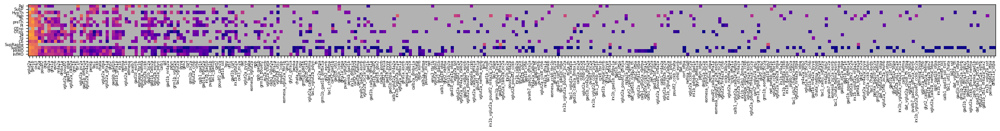

In [37]:
##### the ratio, in log10 scale

cmap = plt.cm.plasma
cmap.set_bad('0.7')  # Set NaN color 

######

Avg_subty_PerBreg_nans = np.zeros((Avg_subty_PerBreg_ratio.shape))
Avg_subty_PerBreg_nans[:] = np.nan
Avg_subty_PerBreg_nans[np.where(Avg_subty_PerBreg_ratio>0)] = Avg_subty_PerBreg_ratio[np.where(Avg_subty_PerBreg_ratio>0)]

temp = np.where(np.nanmax(Avg_subty_PerBreg_nans,1)>0)[0].astype(int)

# plt.figure(figsize=[40,20])
plt.figure(figsize=[28,7])
plt.imshow(np.log10(Avg_subty_PerBreg_nans[temp,::-1]).T, vmin=-3, vmax=0, cmap=cmap)
# plt.colorbar()
# plt.xticks(range(len(np.array(names)[temp])),np.array(names)[temp], rotation = 45,fontsize=6, ha = 'right') 
plt.xticks(range(len(np.array(names)[temp])),np.array(names)[temp], rotation = 90,fontsize=6) 
plt.yticks(range(len(BrainRegions_names_short)),BrainRegions_names_short[::-1],fontsize=6) 
# plt.title("log10 ratio of cells")
# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Subtypes_Brain_Ratio_Matrix_small_r45.svg')

np.savetxt("/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Subtypes_Brain_Ratio_Matrix_small_r45.csv", np.log10(Avg_subty_PerBreg_nans[temp,::-1]).T, delimiter=",")


Text(0.5, 1.0, 'colors for subtypes')

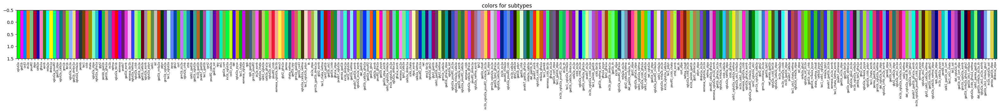

In [29]:
#### the colors for all the subtypes
test_colors = np.zeros((len(colors_All)))
for i in range(len(colors_All)):
    test_colors[i] = i + 1

test_colors = np.vstack((test_colors,test_colors))

plt.figure(figsize = (40,2))
plt.imshow(test_colors[:,temp-1], aspect='auto', cmap=cmap_All,vmin=1, vmax=332)
plt.xticks(range(len(np.array(names)[temp])),np.array(names)[temp], rotation = 90,fontsize=6) 
# plt.xticks(range(len(colors_All)),np.array(good_cls_names), fontsize=8,rotation=90) 
plt.title('colors for subtypes')
# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SubtypeColors_h.svg')

([<matplotlib.axis.YTick at 0x14b6b80f4e90>,
 [Text(0, 0, 'Pal'),
  Text(0, 1, 'SubP'),
  Text(0, 2, 'HypTh'),
  Text(0, 3, 'Hab'),
  Text(0, 4, 'Th'),
  Text(0, 5, 'preTh'),
  Text(0, 6, 'Pt'),
  Text(0, 7, 'OTnp'),
  Text(0, 8, 'OTpv'),
  Text(0, 9, 'NI'),
  Text(0, 10, 'Tg'),
  Text(0, 11, 'Cb'),
  Text(0, 12, 'SupRaphe'),
  Text(0, 13, 'SupMO'),
  Text(0, 14, 'IntMO'),
  Text(0, 15, 'InfMO')])

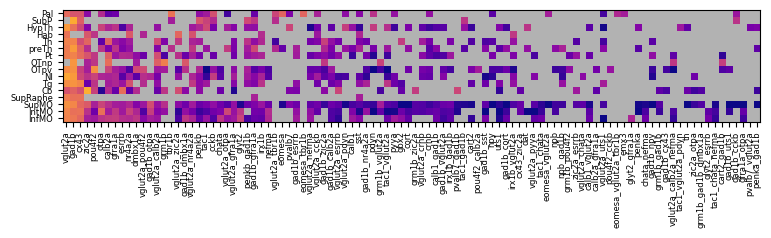

In [30]:

Avg_subty_PerBreg_nans = np.zeros((Avg_subty_PerBreg_ratio.shape))
Avg_subty_PerBreg_nans[:] = np.nan
Avg_subty_PerBreg_nans[np.where(Avg_subty_PerBreg_ratio>0)] = Avg_subty_PerBreg_ratio[np.where(Avg_subty_PerBreg_ratio>0)]

temp = np.where(np.nanmax(Avg_subty_PerBreg_nans,1)>0)[0].astype(int)

# plt.figure(figsize=[40,20])
plt.figure(figsize=[28//3,7])
plt.imshow(np.log10(Avg_subty_PerBreg_nans[temp[0:100],::-1]).T, vmin=-3, vmax=0, cmap=cmap)
# plt.colorbar()

plt.xticks(range(len(np.array(names)[temp[0:100]])),np.array(names)[temp[0:100]], rotation = 90,fontsize=6) 
plt.yticks(range(len(BrainRegions_names_short)),BrainRegions_names_short[::-1],fontsize=6) 
# plt.title("log10 ratio of cells")
# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/Subtypes_Brain_Ratio_Matrix_small_p3.svg')

Text(0.5, 1.0, 'colors for subtypes')

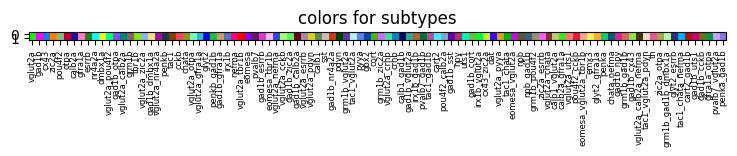

In [31]:
test_colors = np.zeros((len(colors_All)))
for i in range(len(colors_All)):
    test_colors[i] = i + 1

test_colors = np.vstack((test_colors,test_colors))

plt.figure(figsize = (28//3,0.1))
plt.imshow(test_colors[:,temp[0:100]-1], aspect='auto', cmap=cmap_All,vmin=1, vmax=332)
plt.xticks(range(len(np.array(names)[temp[0:100]])),np.array(names)[temp[0:100]], rotation = 90,fontsize=6) 
# plt.xticks(range(len(colors_All)),np.array(good_cls_names), fontsize=8,rotation=90) 
plt.title('colors for subtypes')
# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/SubtypeColors_h_small_p1.svg')

In [32]:
#####################

(25.0, 550.0, -900.0, -50.0)

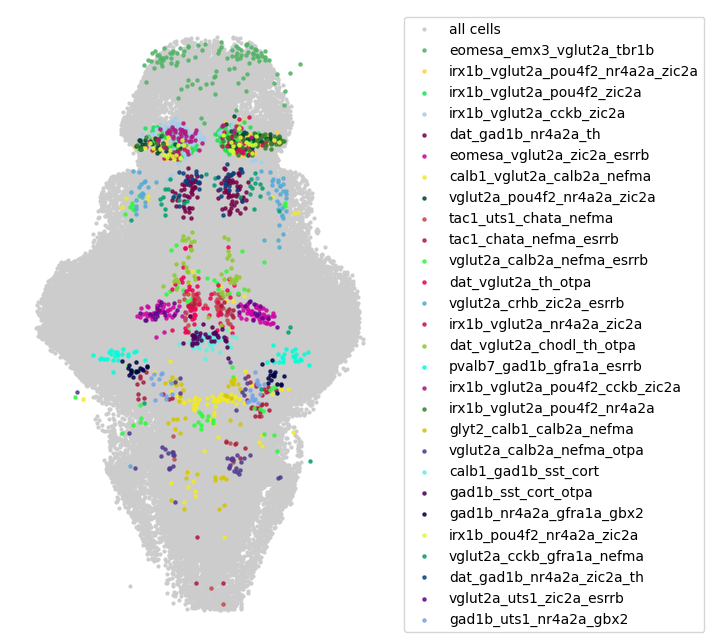

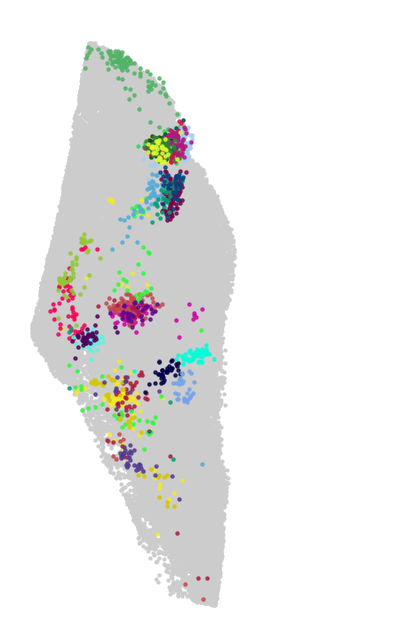

In [33]:
#### subtypes with 4 genes (or more)

minG = 4 #### minimum number of genes in a subtype

temp_f = np.where(fish_id==59)[0]

plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,1],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)


names = ['all cells']

for i, cl in enumerate(list(np.unique(cluster_labelsAll3)[1::][np.where(g_in_cls>=minG)[0]])):
    if cl in glia_subs:
        continue
    temp = np.where(cluster_labelsAll3==cl)[0]
    # print(cl)


    temp2 = fish_id[temp]


    if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:

        if len(np.where(temp2==59)[0])/len(temp2)>0.70 or len(np.where(temp2==63)[0])/len(temp2)>0.70 or len(np.where(temp2==71)[0])/len(temp2)>0.70:
            # print(x, good_cls_names[i], BrainRegions_names[b])
            # print(len(np.where(temp2==59)[0])/len(temp2), len(np.where(temp2==63)[0])/len(temp2), len(np.where(temp2==71)[0])/len(temp2))
            continue
    
        plt.scatter(Coords_All[temp,1],Coords_All[temp,2]*-1,s=5,alpha=0.8,c=colors_All[cl-1])
        names.append(good_cls_names[np.where(g_in_cls>=minG)[0][i]])
plt.legend(names, bbox_to_anchor=(1, 1))

plt.axis('equal')
plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits
plt.gca().invert_xaxis()  # Invert the x-axis
plt.axis('off')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/BrainMap_4Gsubtypes_top.png',transparent=True, dpi=300) 


####### lateral view


plt.figure(figsize=(5,8))
plt.scatter(Coords_All[temp_f,0],Coords_All[temp_f,2]*-1,s=4,c='0.8',alpha=1)


names = ['all cells']

for i, cl in enumerate(list(np.unique(cluster_labelsAll3)[1::][np.where(g_in_cls>=minG)[0]])):
    if cl in glia_subs:
        continue
    temp = np.where(cluster_labelsAll3==cl)[0]
    # print(cl)


    temp2 = fish_id[temp]


    if len(np.where(temp2==59)[0])>4 and len(np.where(temp2==63)[0])>4 and len(np.where(temp2==71)[0])>4:

        if len(np.where(temp2==59)[0])/len(temp2)>0.70 or len(np.where(temp2==63)[0])/len(temp2)>0.70 or len(np.where(temp2==71)[0])/len(temp2)>0.70:
            # print(x, good_cls_names[i], BrainRegions_names[b])
            # print(len(np.where(temp2==59)[0])/len(temp2), len(np.where(temp2==63)[0])/len(temp2), len(np.where(temp2==71)[0])/len(temp2))
            continue

    
        plt.scatter(Coords_All[temp,0],Coords_All[temp,2]*-1,s=5,alpha=0.8,c=colors_All[cl-1])
        names.append(good_cls_names[np.where(g_in_cls>=minG)[0][i]])
# plt.legend(names, bbox_to_anchor=(1, 1))

plt.xlim(25, 550)  # Set x-axis limits
plt.ylim(-900, -50)  # Set y-axis limits
plt.axis('off')

# plt.savefig('/nrs/ahrens/Emmanuel/multFISH/MF59_63_71_analysis/Figure_panels_SVG/Figure4/BrainMap_4Gsubtypes_side.png',transparent=True, dpi=300) 
